In [1]:
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator


In [2]:
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 32
NUM_CLASSES = 5

TRAIN_DIR = "D:/Cherry_Dataset/Cherry/train"
TEST_DIR  = "D:/Cherry_Dataset/Cherry/test"

os.makedirs("saved_models", exist_ok=True)
os.makedirs("histories", exist_ok=True)

RESULTS = {}


In [3]:
def get_generators(preprocess_fn):
    train_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_fn,
        rotation_range=25,
        zoom_range=0.15,
        width_shift_range=0.1,
        height_shift_range=0.1,
        horizontal_flip=True,
        validation_split=0.2
    )

    test_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_fn
    )

    train_gen = train_datagen.flow_from_directory(
        TRAIN_DIR,
        target_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
        class_mode="categorical",
        subset="training"
    )

    val_gen = train_datagen.flow_from_directory(
        TRAIN_DIR,
        target_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
        class_mode="categorical",
        subset="validation"
    )

    test_gen = test_datagen.flow_from_directory(
        TEST_DIR,
        target_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
        class_mode="categorical",
        shuffle=False
    )

    return train_gen, val_gen, test_gen


In [4]:
def build_model(base_fn):
    base = base_fn(
        input_shape=(224,224,3),
        include_top=False,
        weights="imagenet"
    )
    base.trainable = False

    x = GlobalAveragePooling2D()(base.output)
    x = Dense(512, activation="relu")(x)
    x = Dropout(0.5)(x)
    x = Dense(256, activation="relu")(x)
    x = Dropout(0.3)(x)
    output = Dense(NUM_CLASSES, activation="softmax")(x)

    model = Model(base.input, output)

    model.compile(
        optimizer=Adam(1e-4),
        loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.1),
        metrics=["accuracy"]
    )

    return model, base


In [5]:
def train_and_save(
    name,
    base_fn,
    preprocess_fn,
    fine_tune_layers=30
):
    model_path = f"saved_models/{name}.keras"
    hist_path  = f"histories/{name}_history.npy"

    # ✅ Model varsa tekrar eğitme
    if os.path.exists(model_path):
        print(f"✅ {name} bulundu, diskten yükleniyor")
        model = tf.keras.models.load_model(model_path)
        history = np.load(hist_path, allow_pickle=True).item()
        RESULTS[name] = {"model": model, "history": history}
        return

    print(f"\n🚀 Training {name}")

    train_gen, val_gen, test_gen = get_generators(preprocess_fn)
    model, base = build_model(base_fn)

    callbacks = [
        EarlyStopping(patience=5, restore_best_weights=True),
        ReduceLROnPlateau(patience=3, factor=0.3),
        ModelCheckpoint(
            model_path,
            monitor="val_accuracy",
            save_best_only=True,
            verbose=1
        )
    ]

    # 🔹 STAGE 1 — HEAD TRAINING
    history1 = model.fit(
        train_gen,
        validation_data=val_gen,
        epochs=15,
        callbacks=callbacks,
        verbose=1
    )

    # 🔥 STAGE 2 — FINE TUNING
    for layer in base.layers[-fine_tune_layers:]:
        layer.trainable = True

    model.compile(
        optimizer=Adam(1e-5),
        loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.1),
        metrics=["accuracy"]
    )

    history2 = model.fit(
        train_gen,
        validation_data=val_gen,
        epochs=10,
        callbacks=callbacks,
        verbose=1
    )

    # 🔗 History birleştir
    full_history = {}
    for k in history1.history:
        full_history[k] = history1.history[k] + history2.history[k]

    np.save(hist_path, full_history)

    RESULTS[name] = {
        "model": tf.keras.models.load_model(model_path),
        "history": full_history,
        "test_gen": test_gen
    }


In [6]:
train_and_save(
    "DenseNet121",
    tf.keras.applications.DenseNet121,
    tf.keras.applications.densenet.preprocess_input
)

train_and_save(
    "ResNet50",
    tf.keras.applications.ResNet50,
    tf.keras.applications.resnet50.preprocess_input
)

train_and_save(
    "MobileNetV3Small",
    tf.keras.applications.MobileNetV3Small,
    tf.keras.applications.mobilenet_v3.preprocess_input
)

train_and_save(
    "NASNetMobile",
    tf.keras.applications.NASNetMobile,
    tf.keras.applications.nasnet.preprocess_input
)

# ✅ YENİ — MobileNetV2
train_and_save(
    "MobileNetV2",
    tf.keras.applications.MobileNetV2,
    tf.keras.applications.mobilenet_v2.preprocess_input
)

# ✅ YENİ — EfficientNetB0 (dengeli ve güçlü)
train_and_save(
    "EfficientNetB0",
    tf.keras.applications.EfficientNetB0,
    tf.keras.applications.efficientnet.preprocess_input
)

# ✅ YENİ — EfficientNetB2 (bir tık daha derin)
train_and_save(
    "EfficientNetB2",
    tf.keras.applications.EfficientNetB2,
    tf.keras.applications.efficientnet.preprocess_input
)



✅ DenseNet121 bulundu, diskten yükleniyor
✅ ResNet50 bulundu, diskten yükleniyor
✅ MobileNetV3Small bulundu, diskten yükleniyor
✅ NASNetMobile bulundu, diskten yükleniyor
✅ MobileNetV2 bulundu, diskten yükleniyor
✅ EfficientNetB0 bulundu, diskten yükleniyor
✅ EfficientNetB2 bulundu, diskten yükleniyor


In [7]:
from tensorflow.keras.layers import Concatenate



In [8]:
def build_dual_model(
    base_fn1, preprocess1,
    base_fn2, preprocess2,
    name
):
    input_layer = tf.keras.Input(shape=(224,224,3))

    base1 = base_fn1(
        input_shape=(224,224,3),
        include_top=False,
        weights="imagenet"
    )
    base2 = base_fn2(
        input_shape=(224,224,3),
        include_top=False,
        weights="imagenet"
    )

    base1.trainable = False
    base2.trainable = False

    x1 = base1(input_layer)
    x1 = GlobalAveragePooling2D()(x1)

    x2 = base2(input_layer)
    x2 = GlobalAveragePooling2D()(x2)

    merged = Concatenate()([x1, x2])

    x = Dense(512, activation="relu")(merged)
    x = Dropout(0.5)(x)
    x = Dense(256, activation="relu")(x)
    x = Dropout(0.3)(x)

    output = Dense(NUM_CLASSES, activation="softmax")(x)

    model = Model(input_layer, output)

    model.compile(
        optimizer=Adam(1e-4),
        loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.1),
        metrics=["accuracy"]
    )

    return model



In [9]:
def train_dual_model(
    name,
    base_fn1, preprocess_fn1,
    base_fn2, preprocess_fn2
):
    model_path = f"saved_models/{name}.keras"
    hist_path  = f"histories/{name}_history.npy"

    if os.path.exists(model_path):
        print(f"✅ {name} diskten yüklendi")
        model = tf.keras.models.load_model(model_path)
        history = np.load(hist_path, allow_pickle=True).item()
        RESULTS[name] = {"model": model, "history": history}
        return

    print(f"\n🔥 Training DUAL MODEL: {name}")

    # ⚠️ Ortak preprocess (en stabil olan)
    train_gen, val_gen, test_gen = get_generators(preprocess_fn1)

    model = build_dual_model(
        base_fn1, preprocess_fn1,
        base_fn2, preprocess_fn2,
        name
    )

    callbacks = [
        EarlyStopping(patience=6, restore_best_weights=True),
        ReduceLROnPlateau(patience=3, factor=0.3),
        ModelCheckpoint(
            model_path,
            monitor="val_accuracy",
            save_best_only=True,
            verbose=1
        )
    ]

    history = model.fit(
        train_gen,
        validation_data=val_gen,
        epochs=25,
        callbacks=callbacks,
        verbose=1
    )

    np.save(hist_path, history.history)

    RESULTS[name] = {
        "model": model,
        "history": history.history,
        "test_gen": test_gen
    }


In [10]:
# 🥇 1. EN GÜÇLÜ
train_dual_model(
    "Dual_ResNet50_DenseNet121",
    tf.keras.applications.ResNet50,
    tf.keras.applications.resnet50.preprocess_input,
    tf.keras.applications.DenseNet121,
    tf.keras.applications.densenet.preprocess_input
)

# 🥈 2. DENGELİ + STABİL
train_dual_model(
    "Dual_ResNet50_MobileNetV2",
    tf.keras.applications.ResNet50,
    tf.keras.applications.resnet50.preprocess_input,
    tf.keras.applications.MobileNetV2,
    tf.keras.applications.mobilenet_v2.preprocess_input
)

# 🥉 3. HAFİF + DERİN
train_dual_model(
    "Dual_DenseNet121_EfficientNetB0",
    tf.keras.applications.DenseNet121,
    tf.keras.applications.densenet.preprocess_input,
    tf.keras.applications.EfficientNetB0,
    tf.keras.applications.efficientnet.preprocess_input
)


✅ Dual_ResNet50_DenseNet121 diskten yüklendi
✅ Dual_ResNet50_MobileNetV2 diskten yüklendi
✅ Dual_DenseNet121_EfficientNetB0 diskten yüklendi


In [12]:
def train_dual_model(
    name,
    base_fn1, preprocess_fn1,
    base_fn2, preprocess_fn2
):
    model_path = f"saved_models/{name}.keras"
    hist_path  = f"histories/{name}_history.npy"

    # ⚠️ test_gen HER DURUMDA OLUŞTURULUYOR
    # ROC ve Grad-CAM uyumu için şart
    _, _, test_gen = get_generators(preprocess_fn1)

    # ======================================================
    # 🔹 DİSKTEN YÜKLEME
    # ======================================================
    if os.path.exists(model_path):
        print(f"✅ {name} diskten yüklendi")

        model = tf.keras.models.load_model(model_path)
        history = np.load(hist_path, allow_pickle=True).item()

        RESULTS[name] = {
            "model": model,
            "history": history,
            "test_gen": test_gen   # 🔥 KRİTİK SATIR
        }
        return

    # ======================================================
    # 🔹 TRAIN (İLK KEZ)
    # ======================================================
    print(f"\n🔥 Training DUAL MODEL: {name}")

    train_gen, val_gen, _ = get_generators(preprocess_fn1)

    model = build_dual_model(
        base_fn1, preprocess_fn1,
        base_fn2, preprocess_fn2,
        name
    )

    callbacks = [
        EarlyStopping(patience=6, restore_best_weights=True),
        ReduceLROnPlateau(patience=3, factor=0.3),
        ModelCheckpoint(
            model_path,
            monitor="val_accuracy",
            save_best_only=True,
            verbose=1
        )
    ]

    history = model.fit(
        train_gen,
        validation_data=val_gen,
        epochs=25,
        callbacks=callbacks,
        verbose=1
    )

    np.save(hist_path, history.history)

    RESULTS[name] = {
        "model": model,
        "history": history.history,
        "test_gen": test_gen   # 🔥 KRİTİK SATIR
    }


In [14]:
plt.figure(figsize=(10, 8))

for model_name, obj in RESULTS.items():
    model = obj["model"]
    test_gen = obj["test_gen"]

    # Gerçek etiketler
    y_true = test_gen.classes
    y_true_bin = label_binarize(y_true, classes=range(NUM_CLASSES))

    # Tahmin olasılıkları
    y_pred = model.predict(test_gen, verbose=0)

    # Macro-average ROC (HESAPLAMA AYNEN)
    fpr = dict()
    tpr = dict()
    roc_auc = []

    for i in range(NUM_CLASSES):
        fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_pred[:, i])
        roc_auc.append(auc(fpr[i], tpr[i]))

    # 🔹 Aynı eğri, aynı AUC
    plt.plot(
        fpr[0],
        tpr[0],
        label=f"{model_name} (AUC={np.mean(roc_auc):.3f})"
    )

# 🔍 SADECE GÖRSEL ZOOM
plt.xlim(0.0, 0.4)     # FPR tarafında zoom
plt.ylim(0.6, 1.0)     # TPR üst bölge

plt.plot([0, 1], [0, 1], "k--", alpha=0.5)
plt.title("ROC Curve – All Models (Macro Average)")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(fontsize=8)
plt.grid(True)
plt.tight_layout()
plt.show()


KeyError: 'test_gen'

<Figure size 1000x800 with 0 Axes>

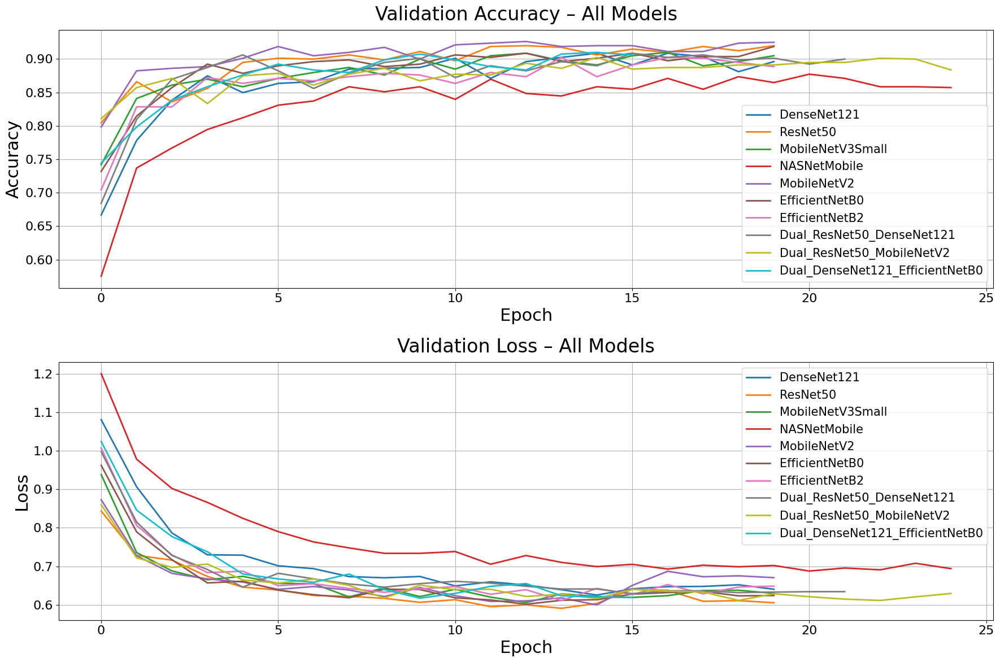

In [13]:
import matplotlib.pyplot as plt

# Genel font ayarları (opsiyonel ama faydalı)
plt.rcParams.update({
    "font.size": 16,
    "axes.titlesize": 24,
    "axes.labelsize": 22,
    "xtick.labelsize": 16,
    "ytick.labelsize": 16,
    "legend.fontsize": 15
})

plt.figure(figsize=(18, 12))

# ---- ACCURACY ----
plt.subplot(2, 1, 1)
for name, obj in RESULTS.items():
    if "val_accuracy" in obj["history"]:
        plt.plot(obj["history"]["val_accuracy"], linewidth=2, label=name)

plt.title("Validation Accuracy – All Models", pad=12)
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.legend(loc="lower right")
plt.grid(True)

# ---- LOSS ----
plt.subplot(2, 1, 2)
for name, obj in RESULTS.items():
    if "val_loss" in obj["history"]:
        plt.plot(obj["history"]["val_loss"], linewidth=2, label=name)

plt.title("Validation Loss – All Models", pad=12)
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.legend(loc="upper right")
plt.grid(True)

plt.tight_layout()
plt.show()


Found 3198 images belonging to 5 classes.
Found 798 images belonging to 5 classes.
Found 999 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

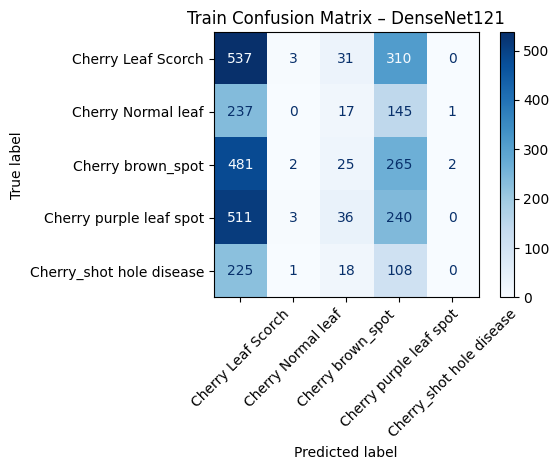

<Figure size 700x700 with 0 Axes>

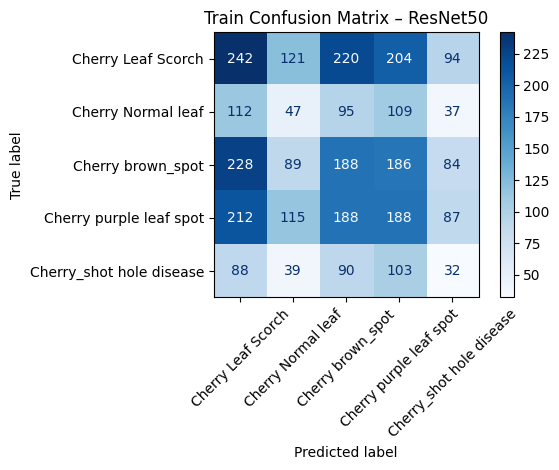

<Figure size 700x700 with 0 Axes>

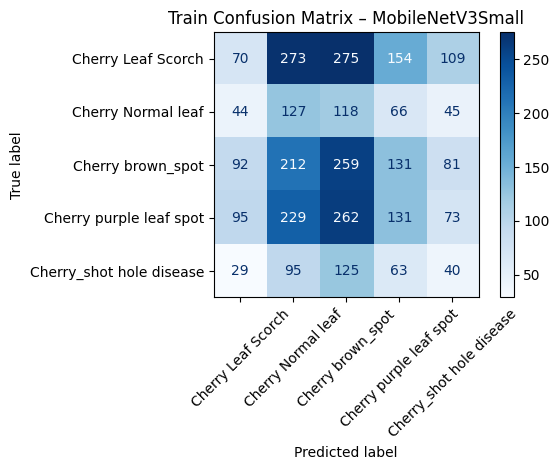

<Figure size 700x700 with 0 Axes>

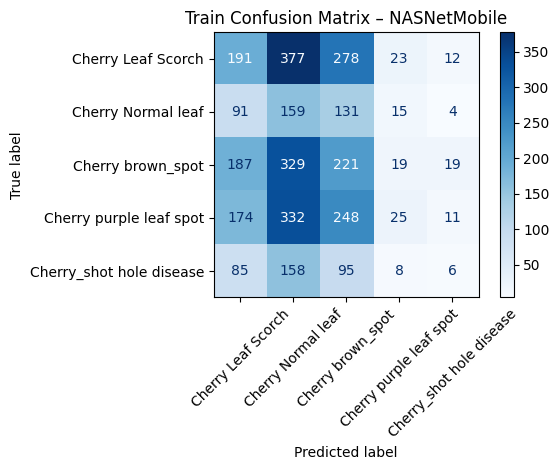

<Figure size 700x700 with 0 Axes>

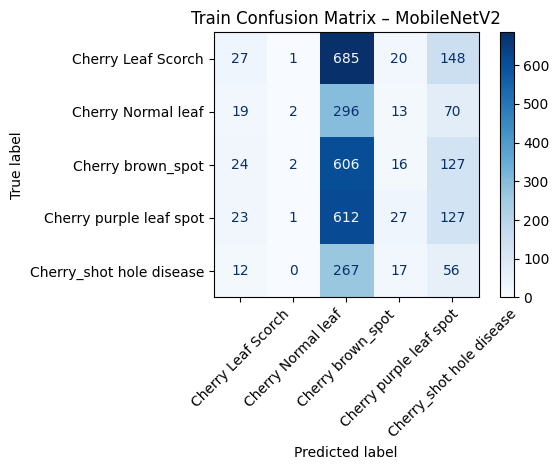

<Figure size 700x700 with 0 Axes>

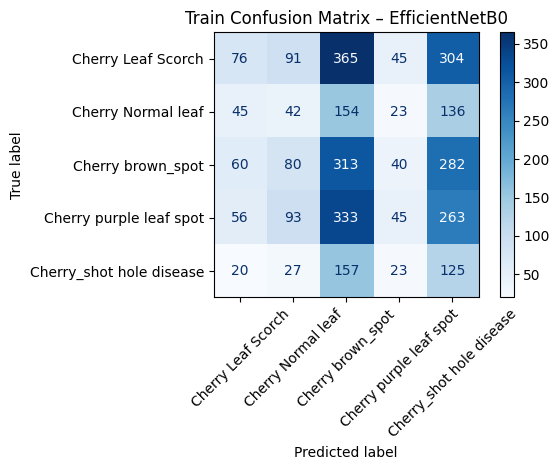

<Figure size 700x700 with 0 Axes>

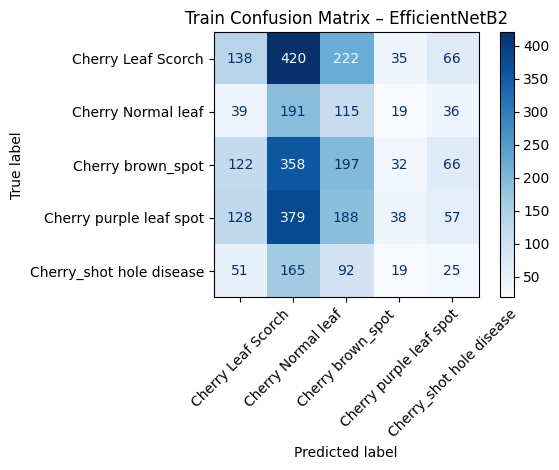

<Figure size 700x700 with 0 Axes>

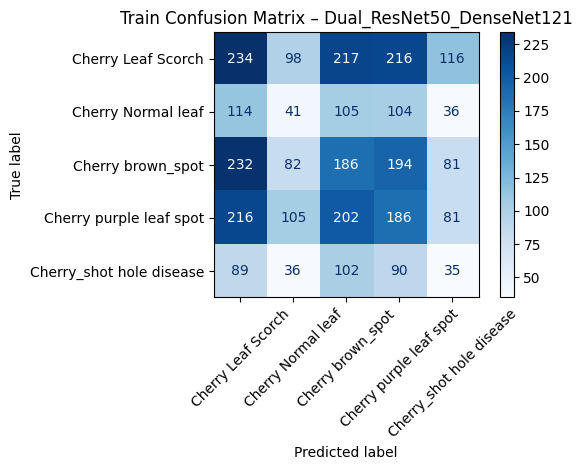

<Figure size 700x700 with 0 Axes>

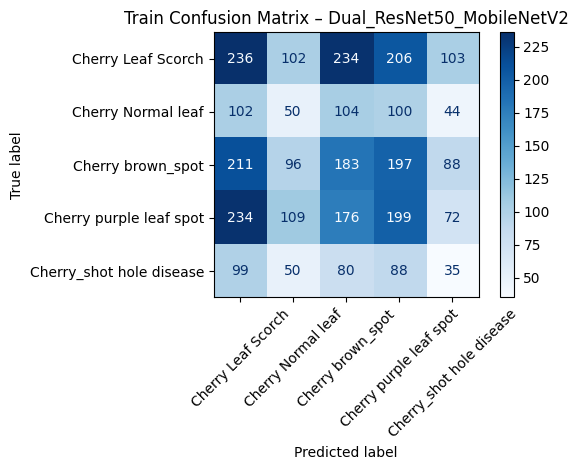

<Figure size 700x700 with 0 Axes>

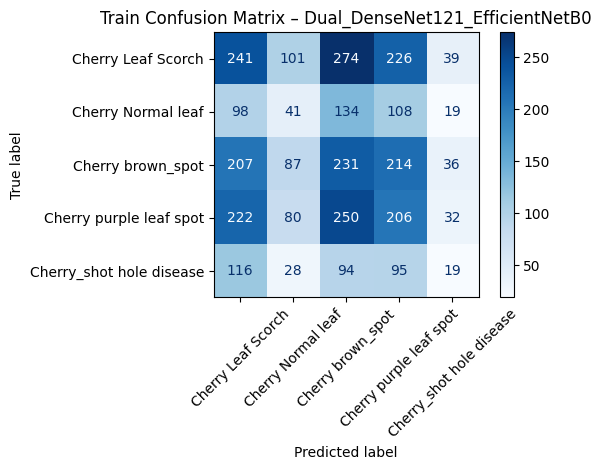

In [19]:
plt.rcParams.update(plt.rcParamsDefault)
# preprocess fonksiyonu önemli (modelle aynı olmalı!)
train_gen, val_gen, test_gen = get_generators(
    tf.keras.applications.resnet50.preprocess_input
)
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import matplotlib.pyplot as plt

train_gen.reset()

for name, obj in RESULTS.items():
    model = obj["model"]

    y_pred = model.predict(train_gen, verbose=0)
    y_pred_cls = np.argmax(y_pred, axis=1)
    y_true = train_gen.classes

    cm = confusion_matrix(y_true, y_pred_cls)

    disp = ConfusionMatrixDisplay(
        confusion_matrix=cm,
        display_labels=list(train_gen.class_indices.keys())
    )

    plt.figure(figsize=(7,7))
    disp.plot(cmap="Blues", values_format="d")
    plt.title(f"Train Confusion Matrix – {name}")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


In [20]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams.update(plt.rcParamsDefault)

def get_clean_train_generator(preprocess_fn):
    clean_datagen = ImageDataGenerator(
        preprocessing_function=preprocess_fn
    )

    train_eval_gen = clean_datagen.flow_from_directory(
        TRAIN_DIR,
        target_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
        class_mode="categorical",
        shuffle=False
    )

    return train_eval_gen


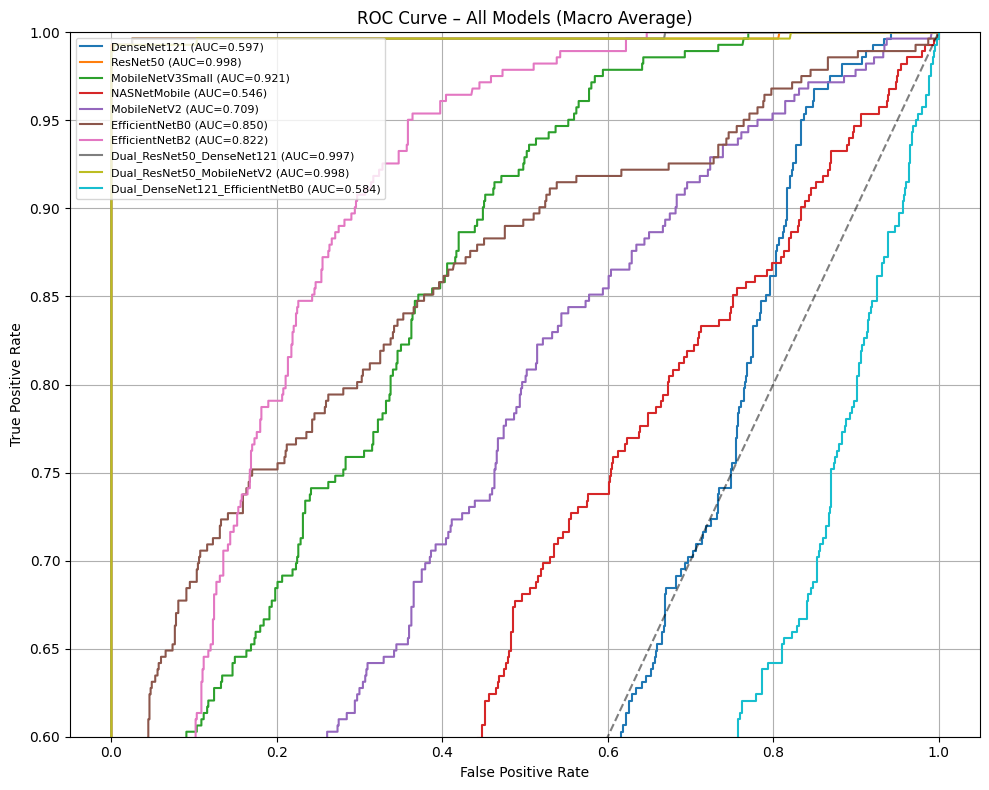

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc

from sklearn.preprocessing import label_binarize
plt.figure(figsize=(10, 8))

# 🔹 TEK test generator (global / daha önce oluşturulmuş)
test_gen = test_gen  # zaten varsa bu satıra gerek bile yok

for model_name, obj in RESULTS.items():
    model = obj["model"]

    # Gerçek etiketler
    y_true = test_gen.classes
    y_true_bin = label_binarize(y_true, classes=range(NUM_CLASSES))

    # Tahmin olasılıkları
    y_pred = model.predict(test_gen, verbose=0)

    fpr = dict()
    tpr = dict()
    roc_auc = []

    for i in range(NUM_CLASSES):
        fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_pred[:, i])
        roc_auc.append(auc(fpr[i], tpr[i]))

    plt.plot(
        fpr[0],
        tpr[0],
        label=f"{model_name} (AUC={np.mean(roc_auc):.3f})"
    )

plt.plot([0, 1], [0, 1], "k--", alpha=0.5)
plt.ylim(0.6, 1.0)

plt.title("ROC Curve – All Models (Macro Average)")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(fontsize=8)
plt.grid(True)
plt.tight_layout()
plt.show()



📊 Train Confusion Matrix (Clean) → DenseNet121
Found 3996 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

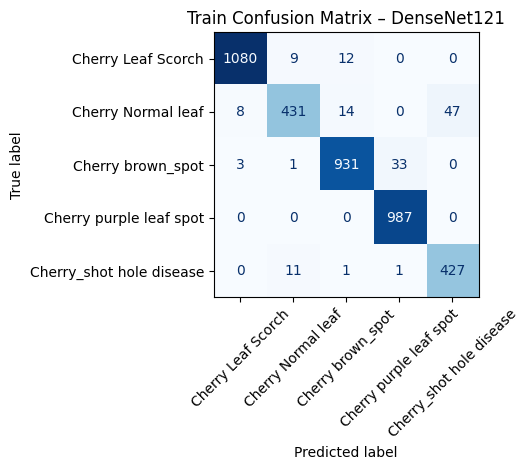


📊 Train Confusion Matrix (Clean) → ResNet50
Found 3996 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

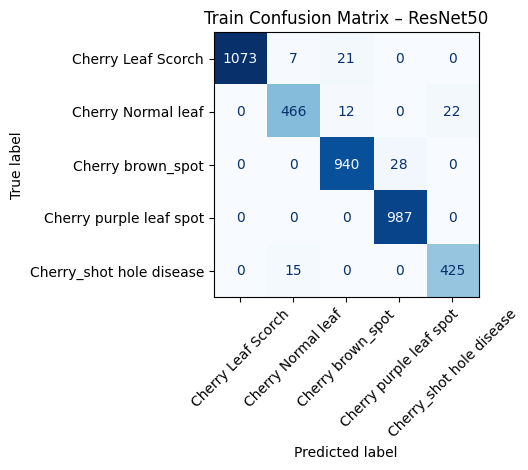


📊 Train Confusion Matrix (Clean) → MobileNetV3Small
Found 3996 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

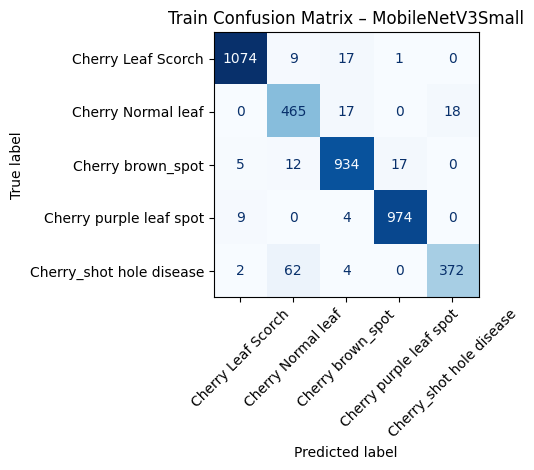


📊 Train Confusion Matrix (Clean) → NASNetMobile
Found 3996 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

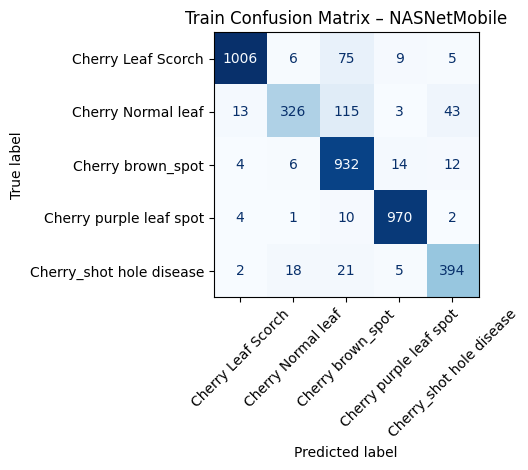


📊 Train Confusion Matrix (Clean) → MobileNetV2
Found 3996 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

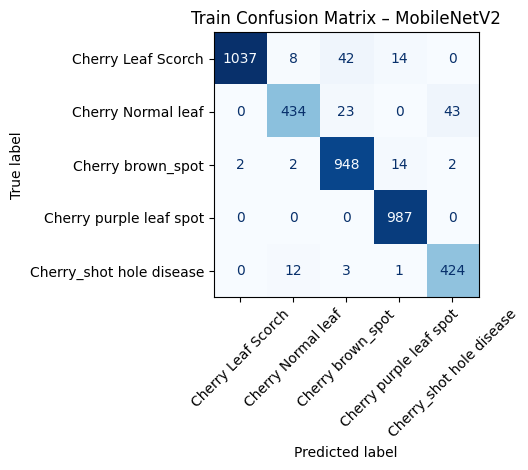


📊 Train Confusion Matrix (Clean) → EfficientNetB0
Found 3996 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

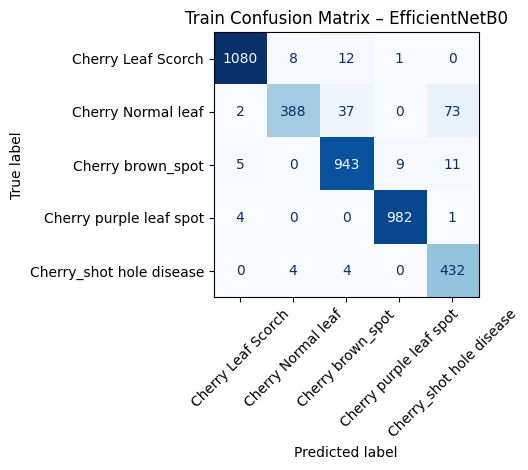


📊 Train Confusion Matrix (Clean) → EfficientNetB2
Found 3996 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

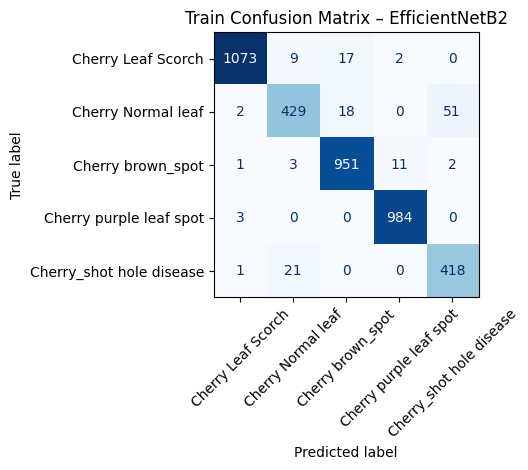


📊 Train Confusion Matrix (Clean) → Dual_ResNet50_DenseNet121
Found 3996 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

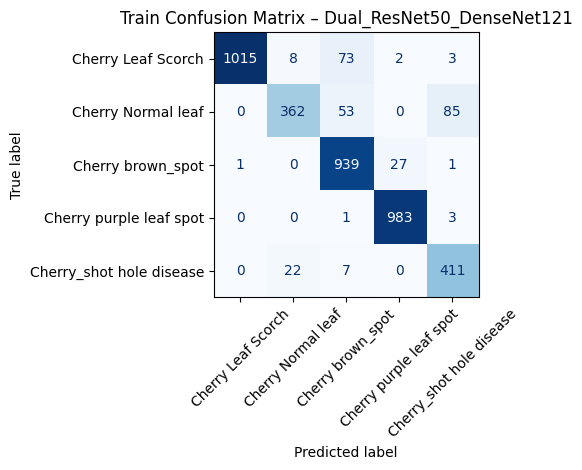


📊 Train Confusion Matrix (Clean) → Dual_ResNet50_MobileNetV2
Found 3996 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

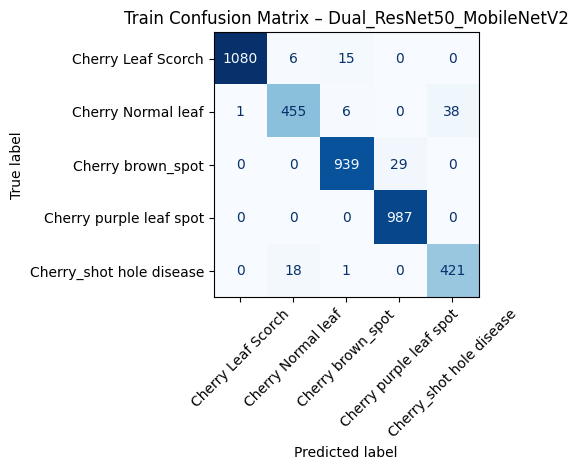


📊 Train Confusion Matrix (Clean) → Dual_DenseNet121_EfficientNetB0
Found 3996 images belonging to 5 classes.


<Figure size 700x700 with 0 Axes>

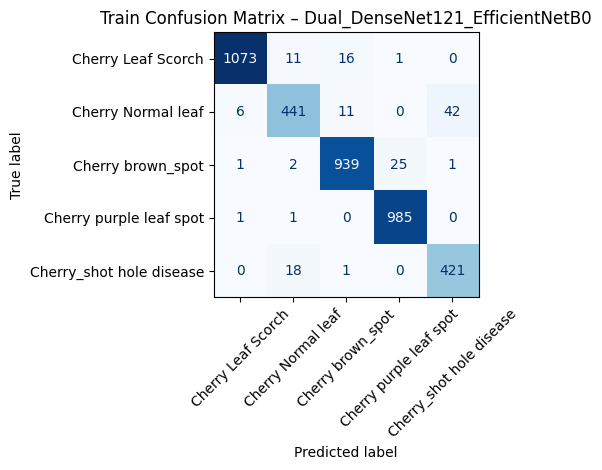

In [22]:
for name, obj in RESULTS.items():
    print(f"\n📊 Train Confusion Matrix (Clean) → {name}")

    model = obj["model"]

    # 🔹 MODELE UYGUN preprocess seç
    if "ResNet" in name:
        preprocess = tf.keras.applications.resnet50.preprocess_input
    elif "DenseNet" in name:
        preprocess = tf.keras.applications.densenet.preprocess_input
    elif "MobileNetV2" in name:
        preprocess = tf.keras.applications.mobilenet_v2.preprocess_input
    elif "MobileNetV3" in name:
        preprocess = tf.keras.applications.mobilenet_v3.preprocess_input
    elif "EfficientNet" in name:
        preprocess = tf.keras.applications.efficientnet.preprocess_input
    elif "NASNet" in name:
        preprocess = tf.keras.applications.nasnet.preprocess_input
    else:
        preprocess = tf.keras.applications.resnet50.preprocess_input

    train_eval_gen = get_clean_train_generator(preprocess)

    y_true = train_eval_gen.classes
    y_pred_prob = model.predict(train_eval_gen, verbose=0)
    y_pred = np.argmax(y_pred_prob, axis=1)

    cm = confusion_matrix(y_true, y_pred)

    disp = ConfusionMatrixDisplay(
        confusion_matrix=cm,
        display_labels=list(train_eval_gen.class_indices.keys())
    )

    plt.figure(figsize=(7,7))
    disp.plot(cmap="Blues", values_format="d", colorbar=False)
    plt.title(f"Train Confusion Matrix – {name}")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

for name, obj in RESULTS.items():
    print(f"\n📊 Confusion Matrix: {name}")

    model = obj["model"]
    train_gen = obj["train_gen"]

    # True & Pred
    y_true = train_gen.classes
    y_prob = model.predict(train_gen, verbose=0)
    y_pred = np.argmax(y_prob, axis=1)

    cm = confusion_matrix(y_true, y_pred)

    disp = ConfusionMatrixDisplay(
        confusion_matrix=cm,
        display_labels=list(train_gen.class_indices.keys())
    )

    fig, ax = plt.subplots(figsize=(6, 6))
    disp.plot(ax=ax, cmap="Blues", colorbar=False)
    plt.title(f"Confusion Matrix – {name}")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()



📊 Confusion Matrix: DenseNet121


KeyError: 'train_gen'


📊 Confusion Matrix: DenseNet121


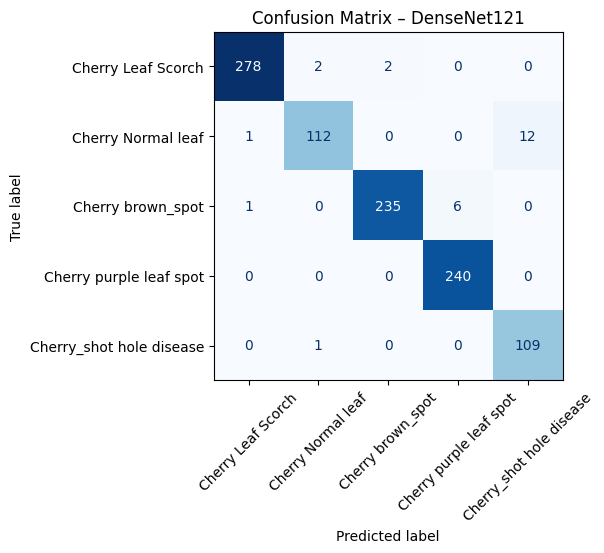


📊 Confusion Matrix: ResNet50


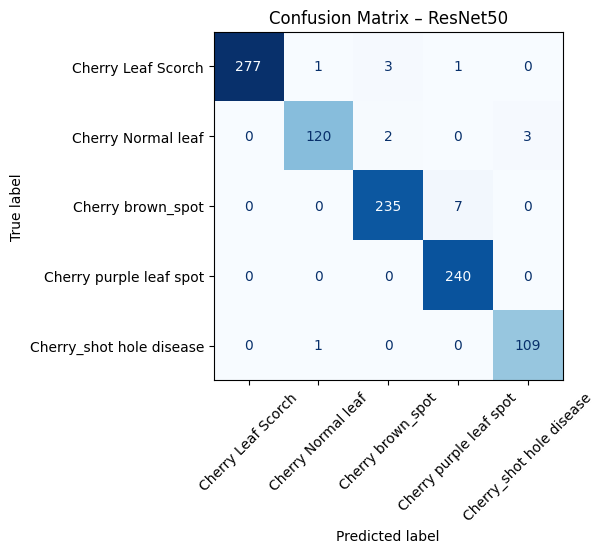


📊 Confusion Matrix: MobileNetV3Small


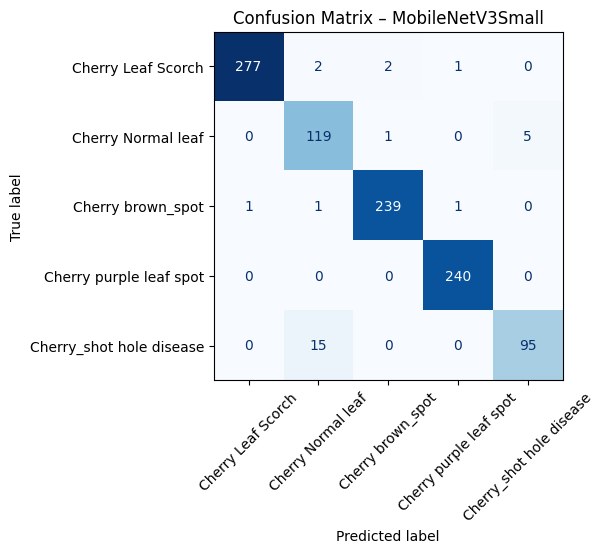


📊 Confusion Matrix: NASNetMobile


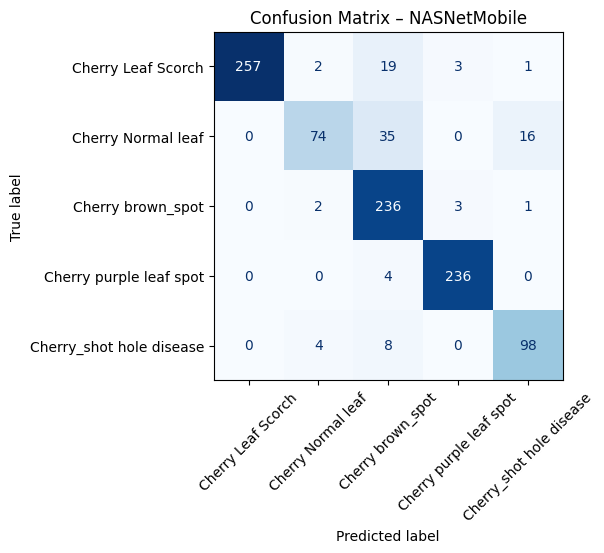


📊 Confusion Matrix: MobileNetV2


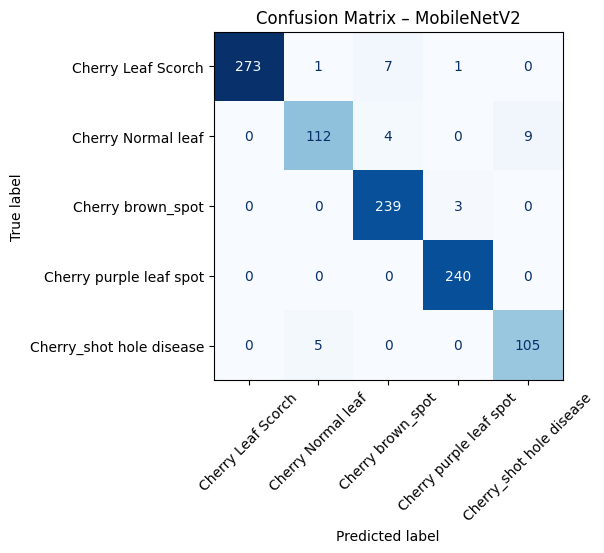


📊 Confusion Matrix: EfficientNetB0


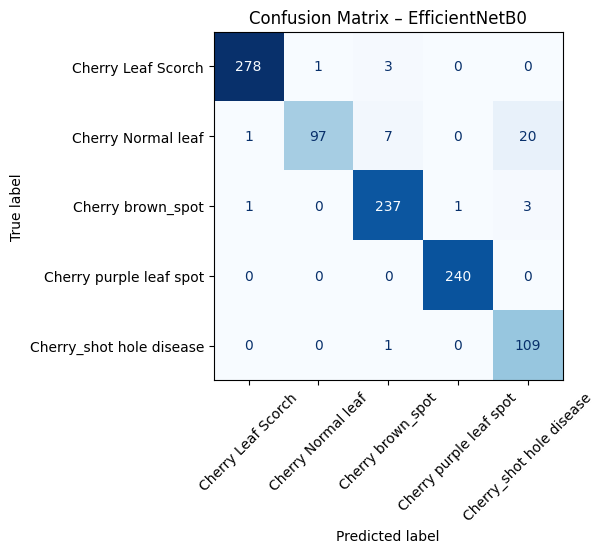


📊 Confusion Matrix: EfficientNetB2


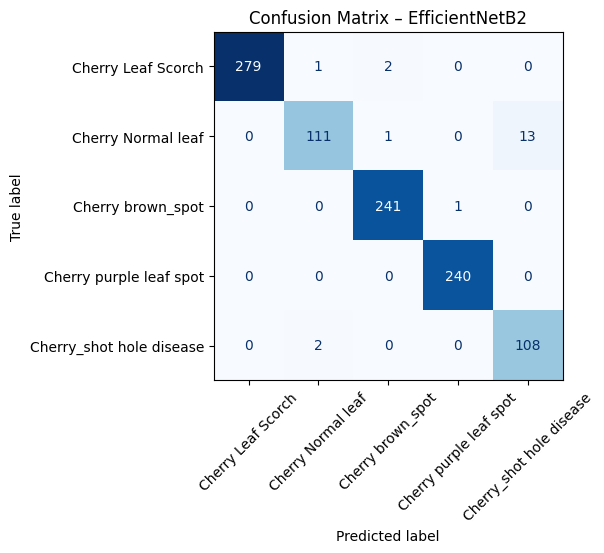


📊 Confusion Matrix: Dual_ResNet50_DenseNet121


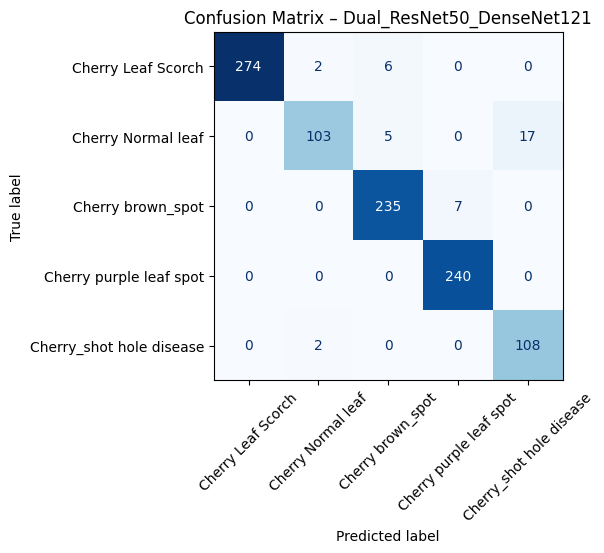


📊 Confusion Matrix: Dual_ResNet50_MobileNetV2


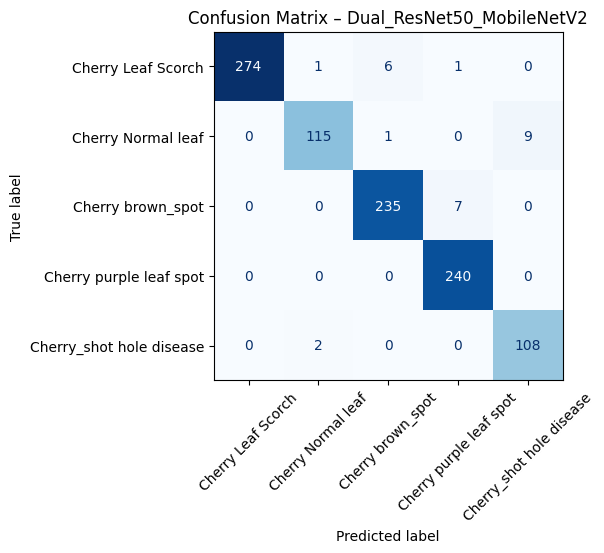


📊 Confusion Matrix: Dual_DenseNet121_EfficientNetB0


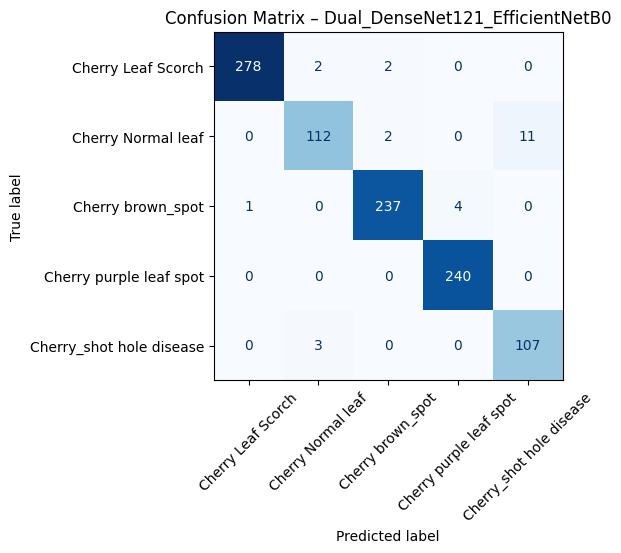

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

for name, obj in RESULTS.items():
    print(f"\n📊 Confusion Matrix: {name}")

    model = obj["model"]
    test_gen = obj["test_gen"]

    # True & Pred
    y_true = test_gen.classes
    y_prob = model.predict(test_gen, verbose=0)
    y_pred = np.argmax(y_prob, axis=1)

    cm = confusion_matrix(y_true, y_pred)

    disp = ConfusionMatrixDisplay(
        confusion_matrix=cm,
        display_labels=list(test_gen.class_indices.keys())
    )

    fig, ax = plt.subplots(figsize=(6, 6))
    disp.plot(ax=ax, cmap="Blues", colorbar=False)
    plt.title(f"Confusion Matrix – {name}")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


In [33]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore
from tf_keras_vis.utils import normalize


In [34]:
def find_last_conv_layer(model):
    for layer in reversed(model.layers):
        if isinstance(layer, tf.keras.layers.Conv2D):
            return layer.name
    raise ValueError("Conv2D layer bulunamadı.")


In [38]:
def get_three_test_images(test_gen, seed=42):
    np.random.seed(seed)
    test_gen.reset()

    x_batch, y_batch = next(test_gen)  # 🔥 DOĞRU KULLANIM

    idx = np.random.choice(len(x_batch), 3, replace=False)

    return x_batch[idx], y_batch[idx]



In [39]:
def run_gradcam_three_images(model, model_name, test_gen):
    print(f"\n🧠 Grad-CAM++ → {model_name}")

    images, labels = get_three_test_images(test_gen)
    last_conv = find_last_conv_layer(model)

    cam = GradcamPlusPlus(
        model,
        model_modifier=ReplaceToLinear(),
        clone=True
    )

    # 🔥 BÜYÜK VE NET FIGURE
    plt.figure(figsize=(21, 10), dpi=130)

    for i in range(3):
        img = images[i]
        label = labels[i]

        score = CategoricalScore(np.argmax(label))

        heatmap = cam(
            score,
            np.expand_dims(img, axis=0),
            penultimate_layer=last_conv
        )
        heatmap = normalize(heatmap[0])

        # 🔹 ÜST: ORİJİNAL
        plt.subplot(2, 3, i + 1)
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"Original Image {i+1}", fontsize=13)

        # 🔥 ALT: GRAD-CAM++
        plt.subplot(2, 3, i + 4)
        plt.imshow(img)
        plt.imshow(heatmap, cmap="jet", alpha=0.45)
        plt.axis("off")
        plt.title(f"Grad-CAM++ {i+1}", fontsize=13)

    plt.suptitle(
        f"Grad-CAM++ Visualization — {model_name}",
        fontsize=18,
        fontweight="bold"
    )

    plt.tight_layout(rect=[0, 0, 1, 0.93])
    plt.show()



🧠 Grad-CAM++ → DenseNet121


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].


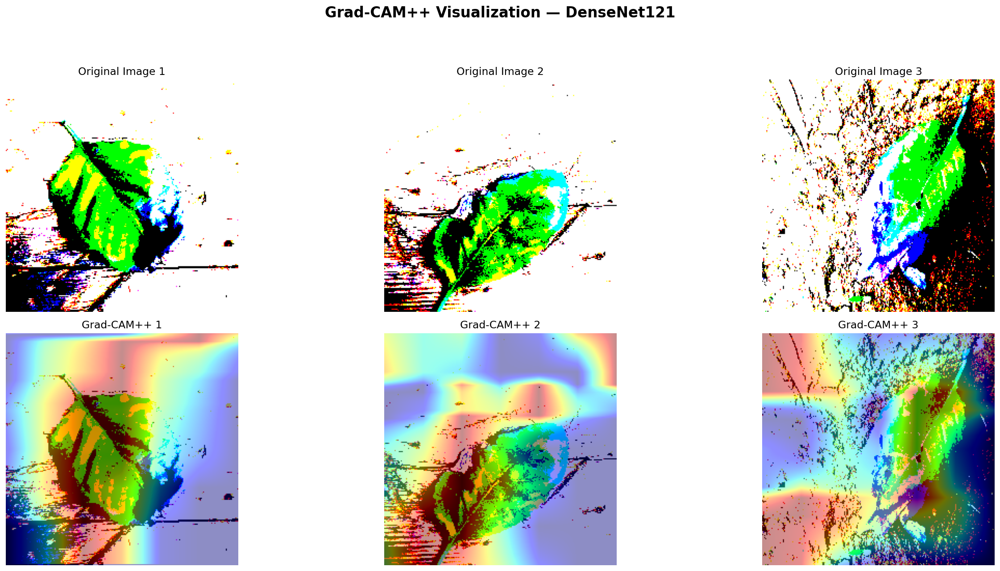


🧠 Grad-CAM++ → ResNet50


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].


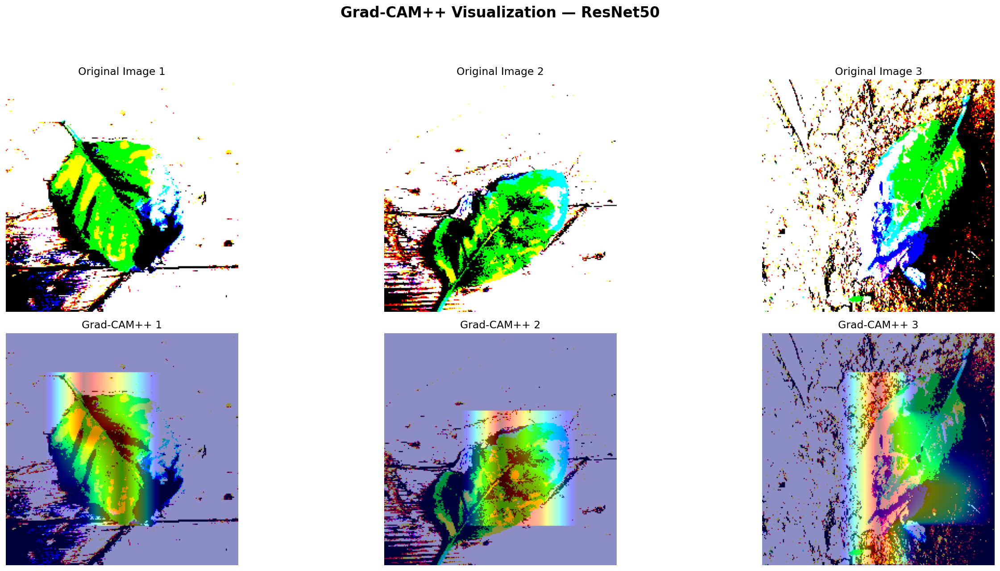


🧠 Grad-CAM++ → MobileNetV3Small


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].


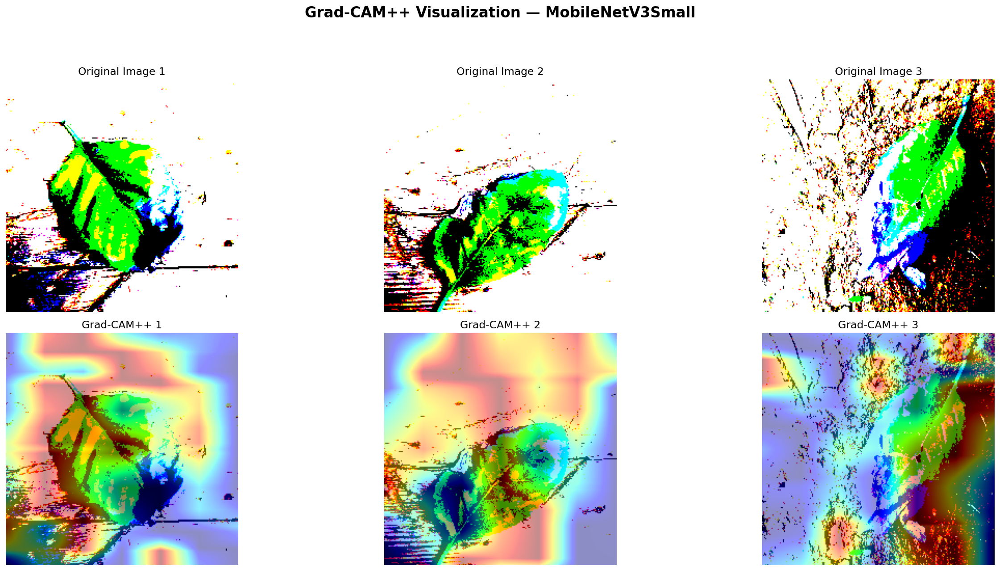


🧠 Grad-CAM++ → NASNetMobile


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].


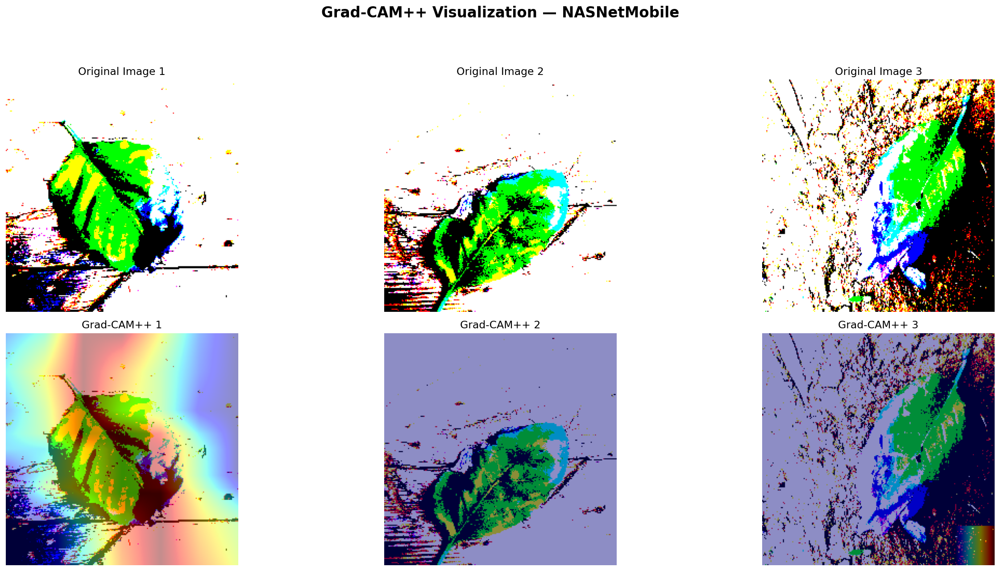


🧠 Grad-CAM++ → MobileNetV2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].


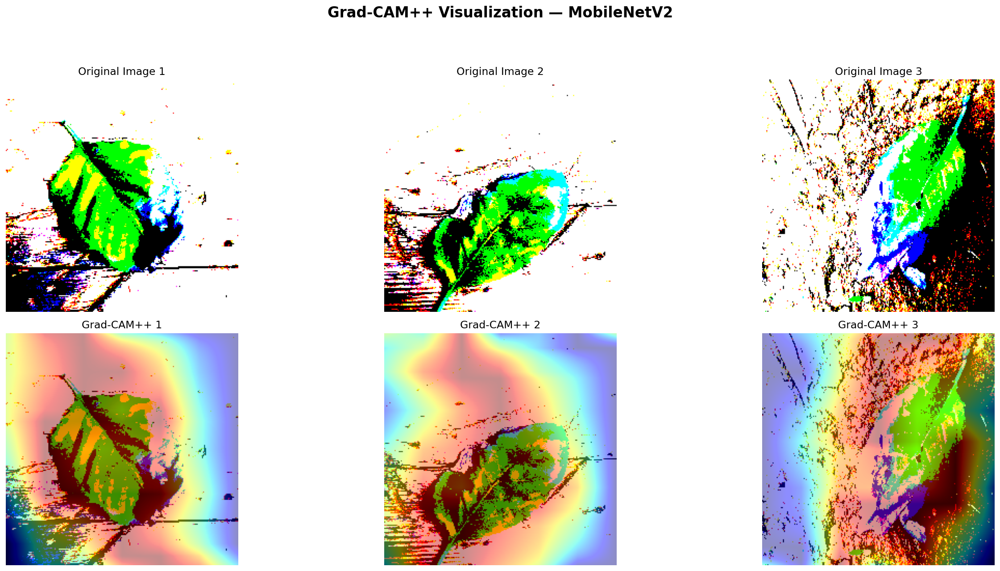


🧠 Grad-CAM++ → EfficientNetB0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].


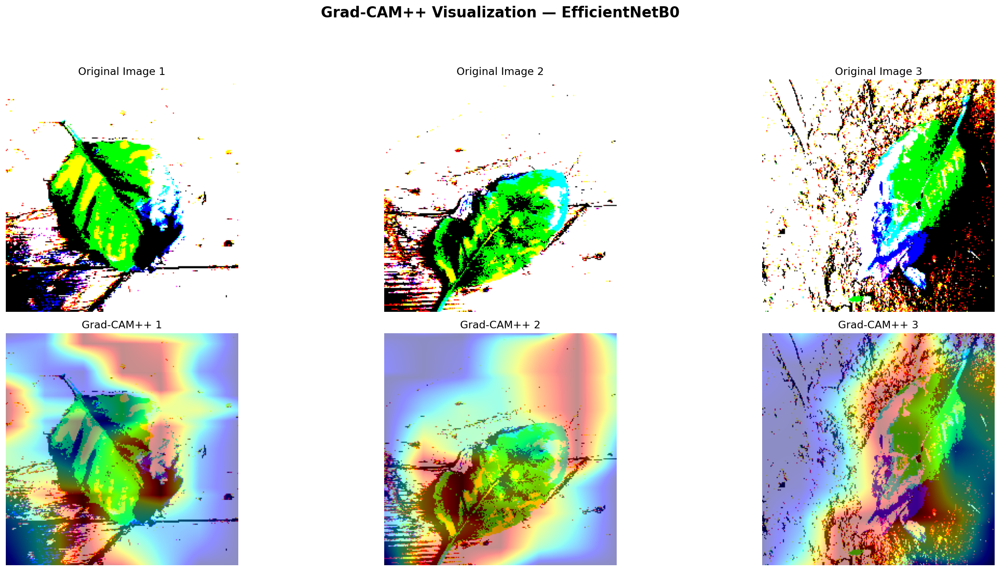


🧠 Grad-CAM++ → EfficientNetB2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..126.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..127.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].


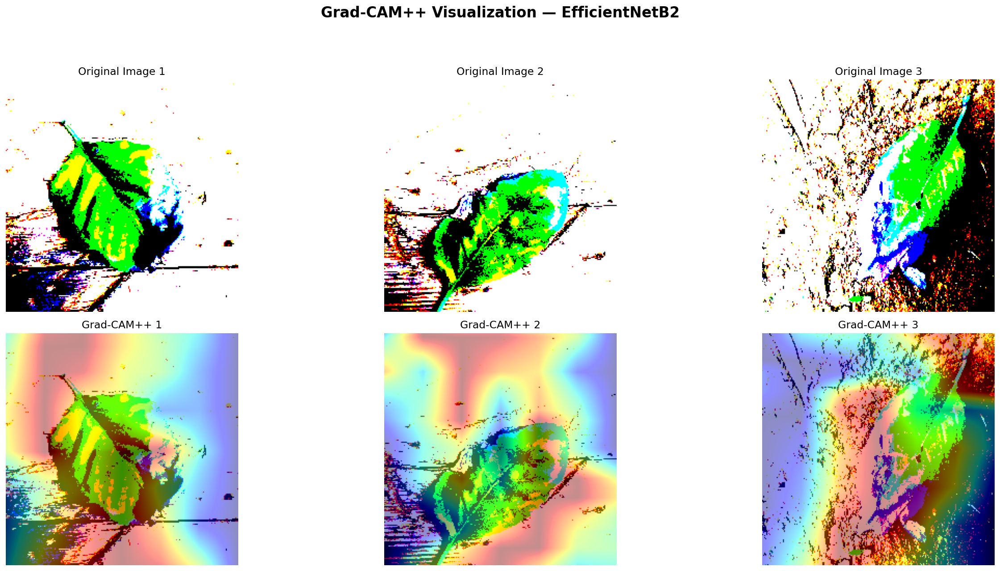

In [40]:
for model_name, obj in RESULTS.items():
    if "Dual" not in model_name:
        run_gradcam_three_images(
            model=obj["model"],
            model_name=model_name,
            test_gen=test_gen   # 🔥 TEK test set
        )



🧠 GradCAM++: ResNet50
🔍 Kullanılan layer: conv5_block3_out


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-116.67998..115.64797].


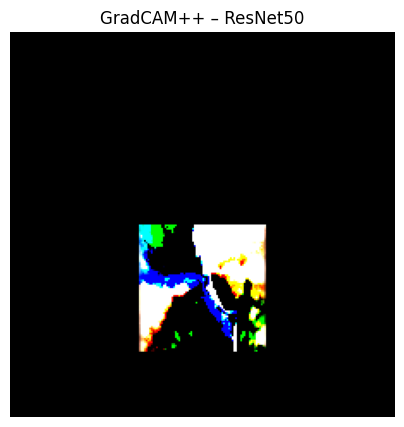


🧠 GradCAM++: Dual_ResNet50_DenseNet121
🔍 Kullanılan layer: densenet121


KeyError: "Exception encountered when calling Functional.call().\n\n\x1b[1m1427414030112\x1b[0m\n\nArguments received by Functional.call():\n  • inputs=['tf.Tensor(shape=(1, 224, 224, 3), dtype=float32)']\n  • training=False\n  • mask=['None']\n  • kwargs=<class 'inspect._empty'>"

In [19]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore
from tf_keras_vis.utils import normalize

# 🔹 Test görüntüsü
test_gen = RESULTS["ResNet50"]["test_gen"]
img, label = test_gen[0]
input_img = img[0]

def find_last_conv_layer(model):
    for layer in reversed(model.layers):
        try:
            if len(layer.output.shape) == 4:
                return layer.name
        except:
            continue
    raise ValueError("Conv layer bulunamadı")

def run_gradcam(model, model_name):
    print(f"\n🧠 GradCAM++: {model_name}")

    last_conv = find_last_conv_layer(model)
    print(f"🔍 Kullanılan layer: {last_conv}")

    score = CategoricalScore(np.argmax(label[0]))

    cam = GradcamPlusPlus(
        model,
        model_modifier=ReplaceToLinear(),
        clone=True
    )

    heatmap = cam(
        score,
        np.expand_dims(input_img, axis=0),
        penultimate_layer=last_conv
    )

    heatmap = normalize(heatmap[0])
    overlay = heatmap[..., np.newaxis] * input_img

    plt.figure(figsize=(5,5))
    plt.imshow(overlay)
    plt.title(f"GradCAM++ – {model_name}")
    plt.axis("off")
    plt.show()


# 🔹 1️⃣ ResNet50 (Single)
run_gradcam(RESULTS["ResNet50"]["model"], "ResNet50")

# 🔹 2️⃣ En İyi Dual
best_dual = "Dual_ResNet50_DenseNet121"
run_gradcam(RESULTS[best_dual]["model"], best_dual)



🧠 GradCAM++ → ResNet50


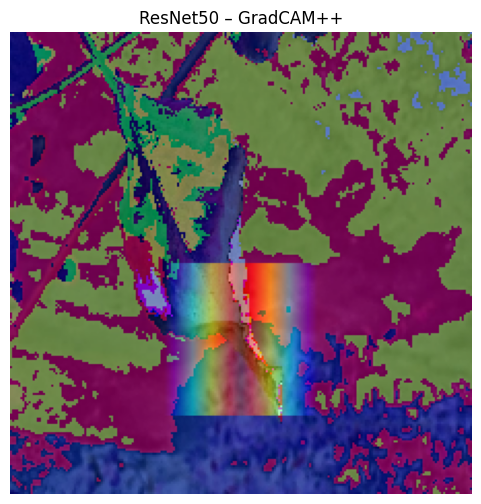


🧠 GradCAM++ → DenseNet121


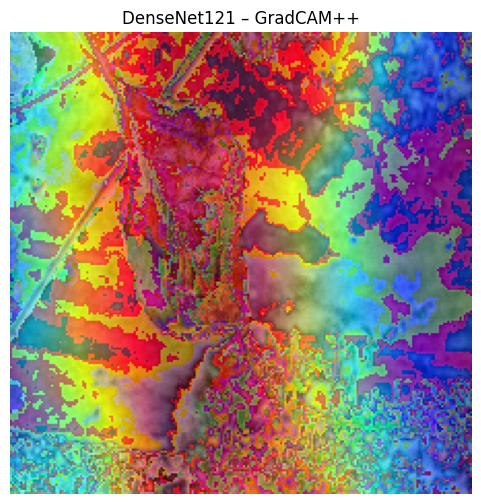


🧠 GradCAM++ → MobileNetV2


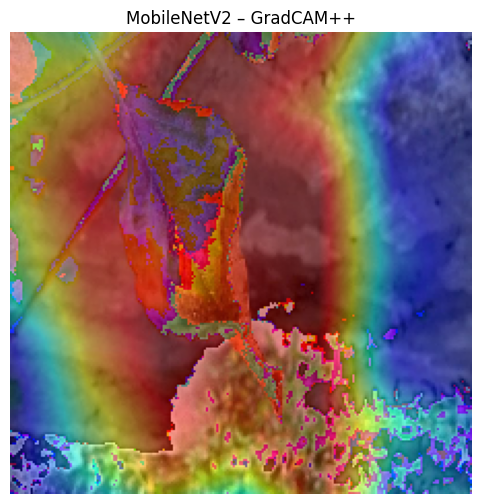


🧠 GradCAM++ → MobileNetV3Small


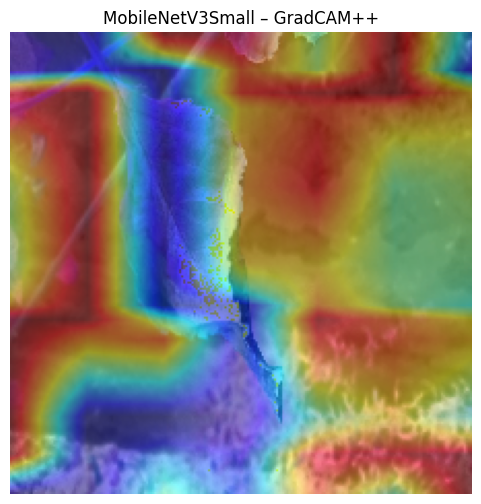


🧠 GradCAM++ → NASNetMobile


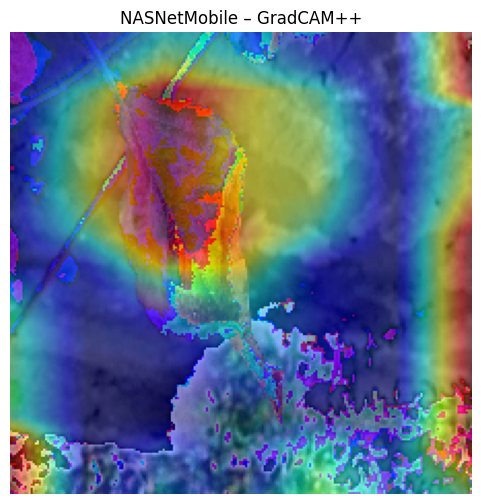


🧠 GradCAM++ → EfficientNetB0


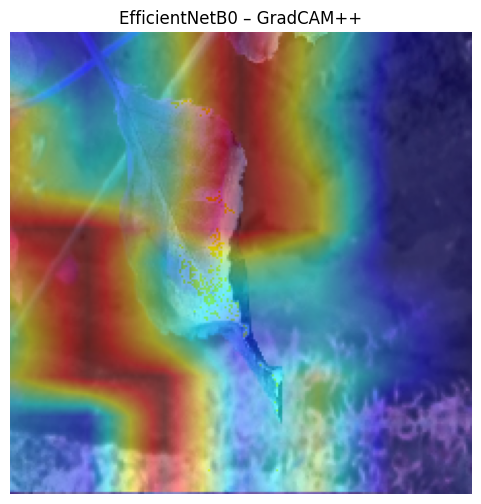


🧠 GradCAM++ → EfficientNetB2


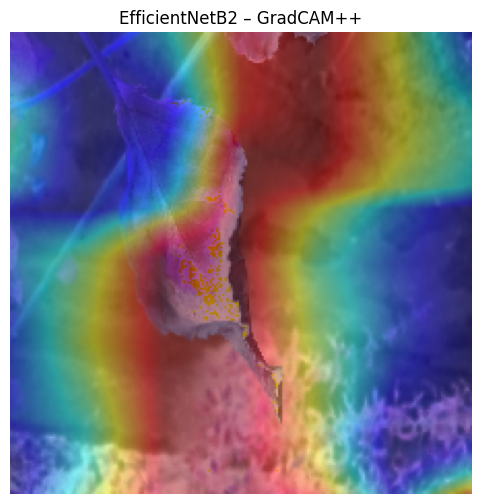

In [22]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore
from tf_keras_vis.utils import normalize


def improved_gradcam(model, model_name, test_gen):
    print(f"\n🧠 GradCAM++ → {model_name}")

    # 🔹 1 adet örnek al
    images, labels = test_gen[0]
    img = images[0]
    label = labels[0]
    pred_class = np.argmax(label)

    # 🔍 Son Conv layer'ı bul
    last_conv = None
    for layer in reversed(model.layers):
        if isinstance(layer, tf.keras.layers.Conv2D):
            last_conv = layer.name
            break

    if last_conv is None:
        print("❌ Conv layer bulunamadı")
        return

    # 🎯 CAM
    score = CategoricalScore(pred_class)

    cam = GradcamPlusPlus(
        model,
        model_modifier=ReplaceToLinear(),
        clone=True
    )

    cam_map = cam(
        score,
        np.expand_dims(img, axis=0),
        penultimate_layer=last_conv
    )[0]

    # 🔥 CAM POST-PROCESS
    cam_map = normalize(cam_map)
    cam_map = cv2.resize(
        cam_map,
        (IMAGE_SIZE[1], IMAGE_SIZE[0]),
        interpolation=cv2.INTER_CUBIC
    )

    heatmap = cv2.applyColorMap(
        np.uint8(255 * cam_map),
        cv2.COLORMAP_JET
    )
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)

    overlay = cv2.addWeighted(
        np.uint8(img * 255),
        0.55,
        heatmap,
        0.45,
        0
    )

    # 🖼️ GÖSTER
    plt.figure(figsize=(6,6))
    plt.imshow(overlay)
    plt.title(f"{model_name} – GradCAM++")
    plt.axis("off")
    plt.show()


# ===============================
# 🚀 TÜM TEKİL MODELLER
# ===============================
single_models = [
    "ResNet50",
    "DenseNet121",
    "MobileNetV2",
    "MobileNetV3Small",
    "NASNetMobile",
    "EfficientNetB0",
    "EfficientNetB2"
]

for name in single_models:
    improved_gradcam(
        RESULTS[name]["model"],
        name,
        RESULTS[name]["test_gen"]
    )



🧠 GradCAM++ → ResNet50


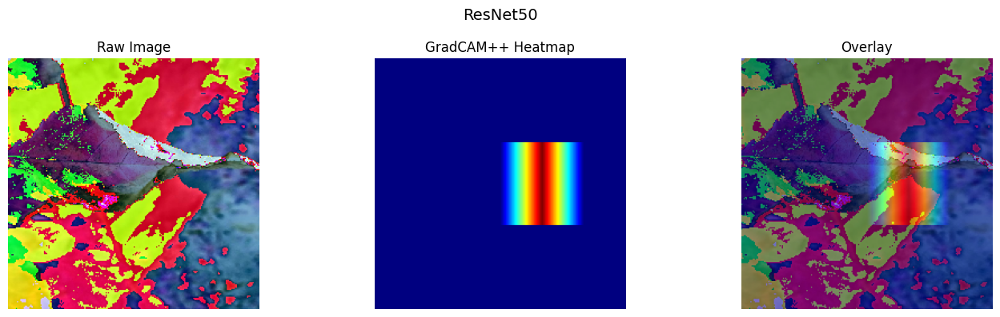


🧠 GradCAM++ → DenseNet121


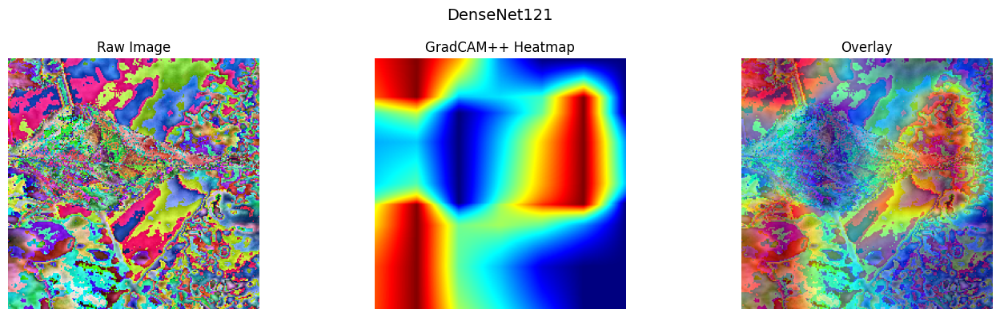


🧠 GradCAM++ → MobileNetV2


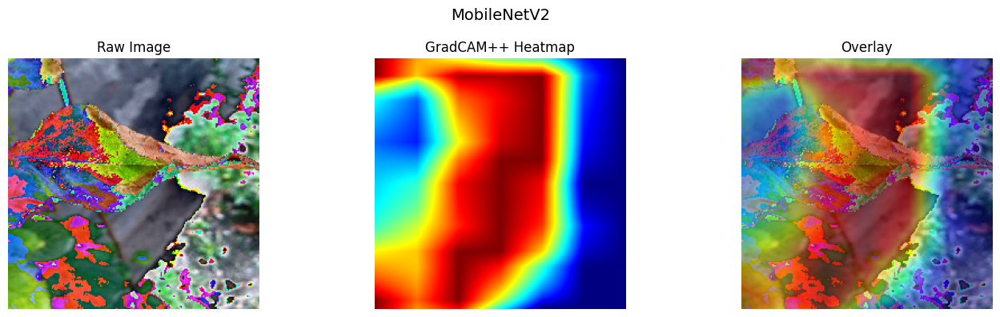


🧠 GradCAM++ → MobileNetV3Small


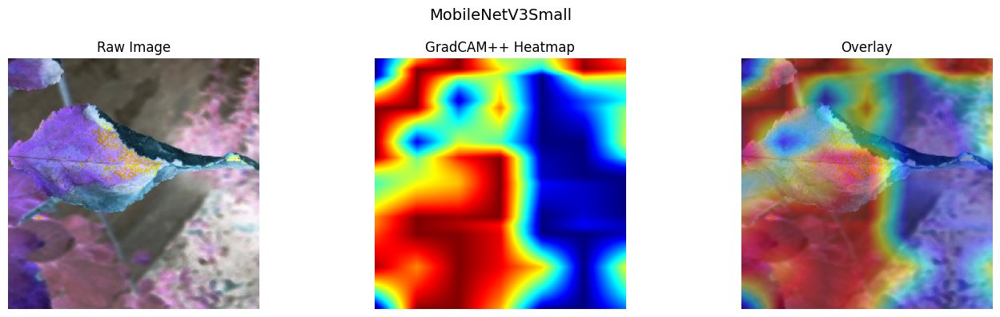


🧠 GradCAM++ → NASNetMobile


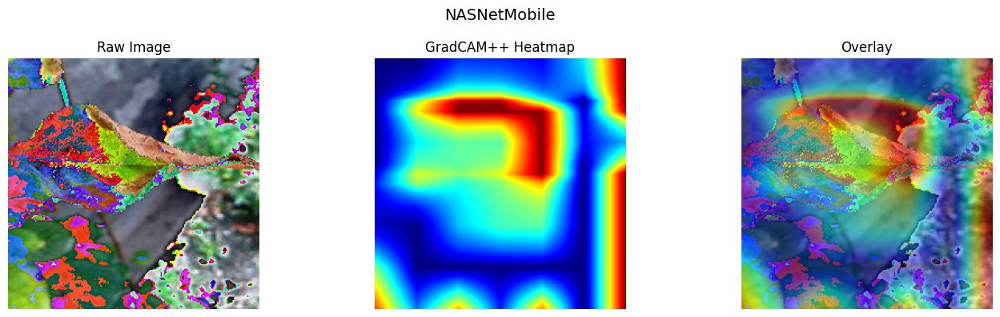


🧠 GradCAM++ → EfficientNetB0


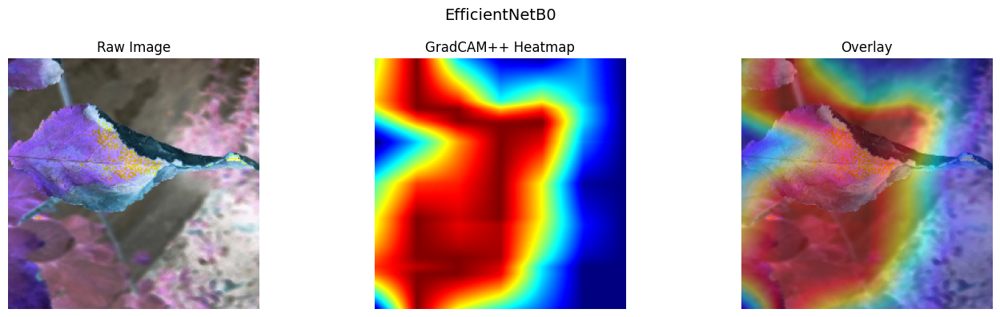


🧠 GradCAM++ → EfficientNetB2


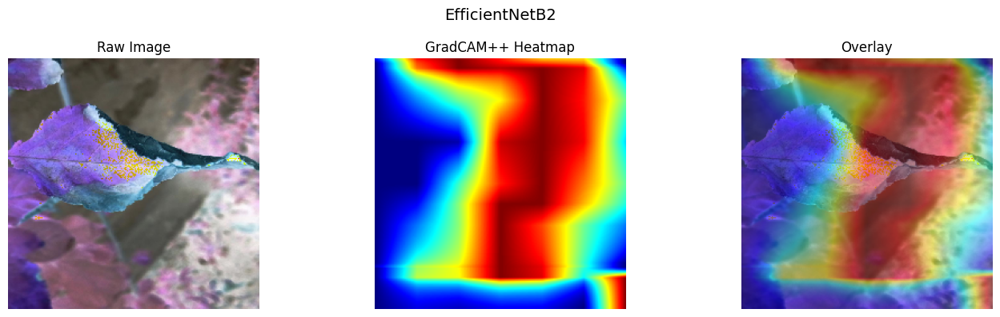

In [34]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore
from tf_keras_vis.utils import normalize


def gradcam_with_raw(model, model_name, test_gen):
    print(f"\n🧠 GradCAM++ → {model_name}")

    # 🔹 Testten örnek
    images, labels = test_gen[0]
    img = images[1]
    label = labels[1]
    class_idx = np.argmax(label)

    # 🔍 Son Conv layer
    last_conv = None
    for layer in reversed(model.layers):
        if isinstance(layer, tf.keras.layers.Conv2D):
            last_conv = layer.name
            break

    if last_conv is None:
        print("❌ Conv layer bulunamadı")
        return

    # 🎯 CAM
    score = CategoricalScore(class_idx)

    cam = GradcamPlusPlus(
        model,
        model_modifier=ReplaceToLinear(),
        clone=True
    )

    cam_map = cam(
        score,
        np.expand_dims(img, axis=0),
        penultimate_layer=last_conv
    )[0]

    cam_map = normalize(cam_map)

    cam_map = cv2.resize(
        cam_map,
        (IMAGE_SIZE[1], IMAGE_SIZE[0]),
        interpolation=cv2.INTER_CUBIC
    )

    heatmap = cv2.applyColorMap(
        np.uint8(255 * cam_map),
        cv2.COLORMAP_JET
    )
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)

    overlay = cv2.addWeighted(
        np.uint8(img * 255),
        0.55,
        heatmap,
        0.45,
        0
    )

    # 🖼️ GÖRSELLEŞTİR
    plt.figure(figsize=(14,4))

    plt.subplot(1,3,1)
    plt.imshow(np.uint8(img * 255))
    plt.title("Raw Image")
    plt.axis("off")

    plt.subplot(1,3,2)
    plt.imshow(heatmap)
    plt.title("GradCAM++ Heatmap")
    plt.axis("off")

    plt.subplot(1,3,3)
    plt.imshow(overlay)
    plt.title("Overlay")
    plt.axis("off")

    plt.suptitle(model_name, fontsize=14)
    plt.tight_layout()
    plt.show()


# ===============================
# 🚀 TÜM TEKİL MODELLER
# ===============================
single_models = [
    "ResNet50",
    "DenseNet121",
    "MobileNetV2",
    "MobileNetV3Small",
    "NASNetMobile",
    "EfficientNetB0",
    "EfficientNetB2"
]

for name in single_models:
    gradcam_with_raw(
        RESULTS[name]["model"],
        name,
        RESULTS[name]["test_gen"]
    )


In [24]:
import numpy as np
import matplotlib.pyplot as plt

# Radar chart için model isimleri ve skorlar
model_names = []
val_accuracies = []

for name, obj in RESULTS.items():
    history = obj["history"]

    # history dict mi keras History mi kontrolü
    if isinstance(history, dict):
        val_acc = max(history["val_accuracy"])
    else:
        val_acc = max(history.history["val_accuracy"])

    model_names.append(name)
    val_accuracies.append(val_acc)

val_accuracies = np.array(val_accuracies)


In [25]:
def plot_radar(models, scores, title="Model Performance Radar Chart"):
    N = len(models)

    angles = np.linspace(0, 2 * np.pi, N, endpoint=False).tolist()
    scores = scores.tolist()

    # Kapatmak için ilk değeri sona ekle
    scores += scores[:1]
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(polar=True))

    ax.plot(angles, scores, linewidth=2)
    ax.fill(angles, scores, alpha=0.25)

    ax.set_thetagrids(np.degrees(angles[:-1]), models)
    ax.set_ylim(0, 1)

    ax.set_title(title, size=16, pad=20)

    # Değerleri yaz
    for angle, score in zip(angles, scores):
        ax.text(angle, score + 0.02, f"{score:.2f}", ha='center', va='center', fontsize=9)

    plt.show()


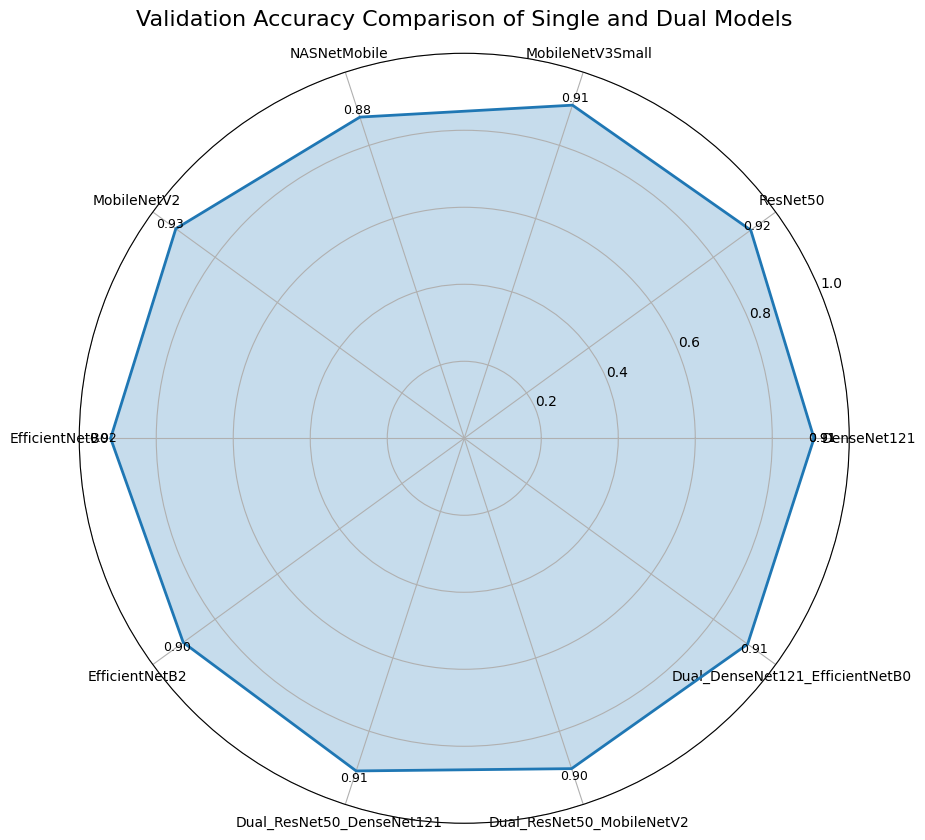

In [26]:
plot_radar(
    model_names,
    val_accuracies,
    title="Validation Accuracy Comparison of Single and Dual Models"
)


In [27]:
def plot_radar(models, scores, title="Model Performance Radar Chart"):
    N = len(models)

    angles = np.linspace(0, 2 * np.pi, N, endpoint=False).tolist()
    scores = scores.tolist()

    # Kapalı radar
    scores += scores[:1]
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(11, 11), subplot_kw=dict(polar=True))

    ax.plot(angles, scores, linewidth=2)
    ax.fill(angles, scores, alpha=0.25)

    # 🔹 Model isimlerini dışarı al
    ax.set_thetagrids(np.degrees(angles[:-1]), models)
    ax.tick_params(axis='x', pad=25)

    ax.set_ylim(0, 1)
    ax.set_title(title, size=16, pad=30)

    # 🔹 Skor yazılarını akıllı yerleştir
    for angle, score in zip(angles[:-1], scores[:-1]):
        ax.text(
            angle,
            score + 0.06,            # dışarı kaydır
            f"{score:.2f}",
            ha='center',
            va='center',
            fontsize=9,
            bbox=dict(boxstyle="round,pad=0.2", fc="white", ec="none", alpha=0.7)
        )

    plt.show()


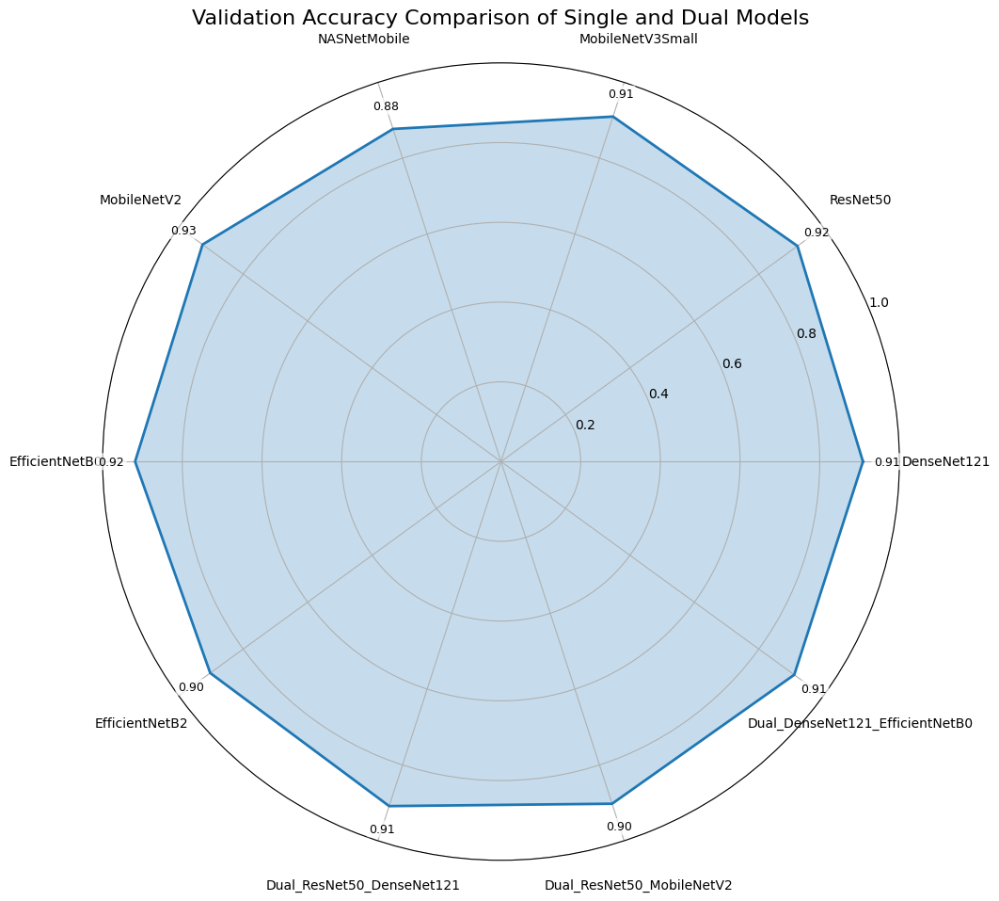

In [28]:
plot_radar(
    model_names,
    val_accuracies,
    title="Validation Accuracy Comparison of Single and Dual Models"
)


In [29]:
import numpy as np
import pandas as pd
from sklearn.metrics import (
    accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    matthews_corrcoef,
    roc_auc_score,
    confusion_matrix
)
from sklearn.preprocessing import label_binarize
import math

def compute_metrics(model, test_gen):
    # 🔹 True labels
    y_true = test_gen.classes
    class_names = list(test_gen.class_indices.keys())
    n_classes = len(class_names)

    # 🔹 Predictions
    y_prob = model.predict(test_gen, verbose=0)
    y_pred = np.argmax(y_prob, axis=1)

    # 🔹 Accuracy
    acc = accuracy_score(y_true, y_pred)

    # 🔹 Precision / Recall / F1 (macro)
    precision = precision_score(y_true, y_pred, average="macro", zero_division=0)
    recall = recall_score(y_true, y_pred, average="macro", zero_division=0)
    f1 = f1_score(y_true, y_pred, average="macro", zero_division=0)

    # 🔹 Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)

    # 🔹 Specificity (macro)
    specificity_list = []
    for i in range(n_classes):
        tn = np.sum(np.delete(np.delete(cm, i, axis=0), i, axis=1))
        fp = np.sum(cm[:, i]) - cm[i, i]
        specificity_list.append(tn / (tn + fp + 1e-9))
    specificity = np.mean(specificity_list)

    # 🔹 MCC
    mcc = matthews_corrcoef(y_true, y_pred)

    # 🔹 G-Mean
    gmean = math.sqrt(recall * specificity)

    # 🔹 AUC (One-vs-Rest, macro)
    y_true_bin = label_binarize(y_true, classes=range(n_classes))
    auc = roc_auc_score(y_true_bin, y_prob, average="macro", multi_class="ovr")

    return [
        acc, precision, recall, specificity,
        f1, mcc, gmean, auc
    ]

# ==========================================================
# 📊 TABLE 3 — PERFORMANCE COMPARISON
# ==========================================================
rows = []

for model_name, obj in RESULTS.items():
    print(f"📐 Metrics hesaplanıyor → {model_name}")
    metrics = compute_metrics(obj["model"], obj["test_gen"])
    rows.append([model_name] + metrics)

columns = [
    "Model",
    "Accuracy",
    "Precision",
    "Recall",
    "Specificity",
    "F1-Score",
    "MCC",
    "G-Mean",
    "AUC"
]

df_table3 = pd.DataFrame(rows, columns=columns)

# 🔹 4 ondalık gösterim (makale standardı)
df_table3.iloc[:, 1:] = df_table3.iloc[:, 1:].astype(float).round(4)

df_table3



📐 Metrics hesaplanıyor → DenseNet121
📐 Metrics hesaplanıyor → ResNet50
📐 Metrics hesaplanıyor → MobileNetV3Small
📐 Metrics hesaplanıyor → NASNetMobile
📐 Metrics hesaplanıyor → MobileNetV2
📐 Metrics hesaplanıyor → EfficientNetB0
📐 Metrics hesaplanıyor → EfficientNetB2
📐 Metrics hesaplanıyor → Dual_ResNet50_DenseNet121
📐 Metrics hesaplanıyor → Dual_ResNet50_MobileNetV2
📐 Metrics hesaplanıyor → Dual_DenseNet121_EfficientNetB0


,Model,Accuracy,Precision,Recall,Specificity,F1-Score,MCC,G-Mean,AUC
0,DenseNet121,0.9750,0.9670,0.9688,0.9939,0.9670,0.9680,0.9813,0.9980
1,ResNet50,0.9820,0.9807,0.9809,0.9954,0.9807,0.9769,0.9881,0.9985
2,MobileNetV3Small,0.9710,0.9589,0.9571,0.9932,0.9572,0.9628,0.9750,0.9974
3,NASNetMobile,0.9019,0.9008,0.8706,0.9751,0.8766,0.8766,0.9213,0.9930
4,MobileNetV2,0.9700,0.9620,0.9612,0.9926,0.9613,0.9615,0.9768,0.9981
5,EfficientNetB0,0.9620,0.9520,0.9464,0.9909,0.9451,0.9518,0.9684,0.9978
6,EfficientNetB2,0.9800,0.9700,0.9710,0.9953,0.9697,0.9744,0.9831,0.9984
7,Dual_ResNet50_DenseNet121,0.9610,0.9507,0.9497,0.9905,0.9483,0.9501,0.9699,0.9975
8,Dual_ResNet50_MobileNetV2,0.9730,0.9673,0.9689,0.9933,0.9677,0.9653,0.9810,0.9978
9,Dual_DenseNet121_EfficientNetB0,0.9750,0.9655,0.9668,0.9940,0.9657,0.9679,0.9803,0.9968


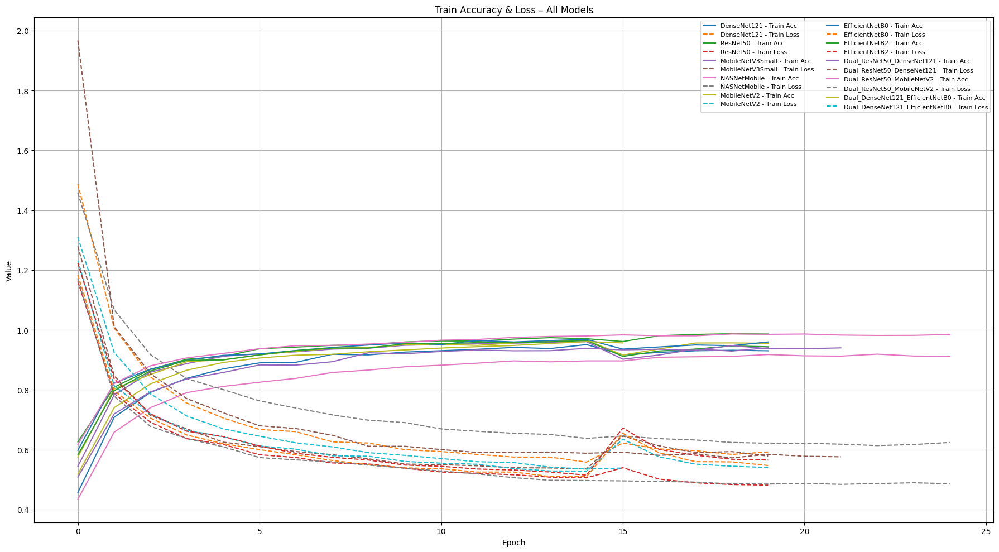

In [32]:
import matplotlib.pyplot as plt

def get_history_data(h):
    """
    History objesi veya dict fark etmeksizin
    accuracy ve loss döndürür
    """
    if isinstance(h, dict):
        return h["accuracy"], h["loss"]
    else:  # keras.callbacks.History
        return h.history["accuracy"], h.history["loss"]


plt.figure(figsize=(18, 10))

for model_name, obj in RESULTS.items():
    acc, loss = get_history_data(obj["history"])

    # Train Accuracy
    plt.plot(
        acc,
        label=f"{model_name} - Train Acc"
    )

    # Train Loss (kesikli)
    plt.plot(
        loss,
        linestyle="--",
        label=f"{model_name} - Train Loss"
    )

plt.title("Train Accuracy & Loss – All Models")
plt.xlabel("Epoch")
plt.ylabel("Value")
plt.grid(True)
plt.legend(fontsize=8, ncol=2)
plt.tight_layout()
plt.show()


⚠️ DenseNet121 için y_true / y_pred yok, atlandı.
⚠️ ResNet50 için y_true / y_pred yok, atlandı.
⚠️ MobileNetV3Small için y_true / y_pred yok, atlandı.
⚠️ NASNetMobile için y_true / y_pred yok, atlandı.
⚠️ MobileNetV2 için y_true / y_pred yok, atlandı.
⚠️ EfficientNetB0 için y_true / y_pred yok, atlandı.
⚠️ EfficientNetB2 için y_true / y_pred yok, atlandı.
⚠️ Dual_ResNet50_DenseNet121 için y_true / y_pred yok, atlandı.
⚠️ Dual_ResNet50_MobileNetV2 için y_true / y_pred yok, atlandı.
⚠️ Dual_DenseNet121_EfficientNetB0 için y_true / y_pred yok, atlandı.


C:\Users\hysen\AppData\Local\Temp\ipykernel_18612\3397995335.py:46: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(


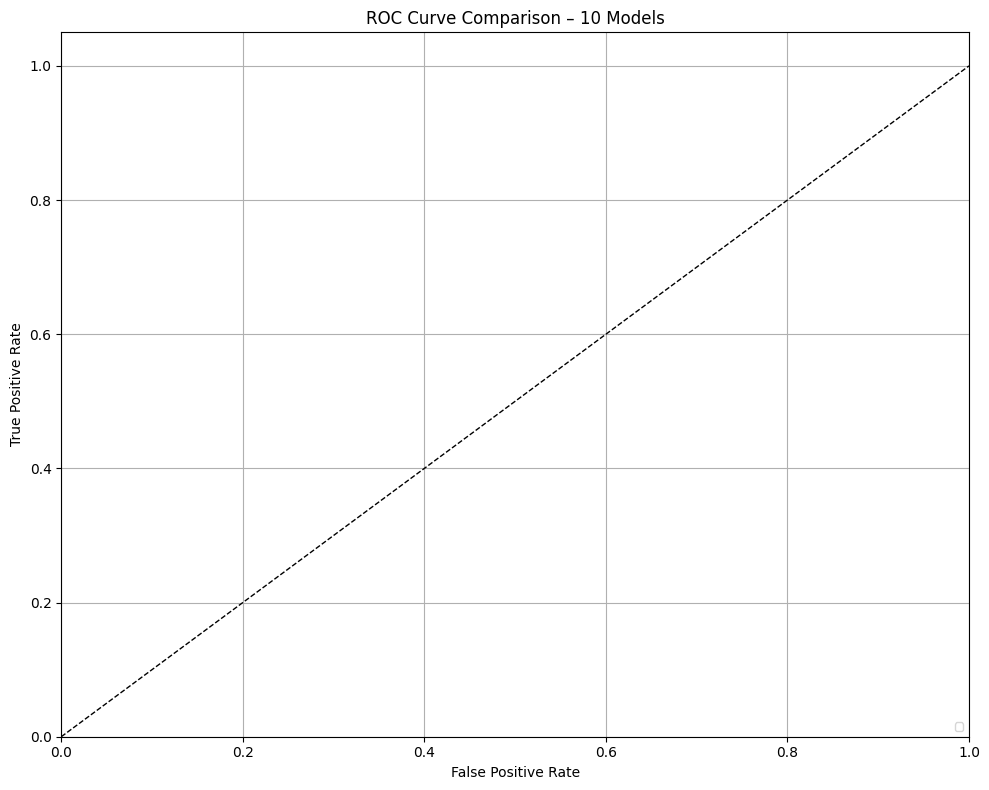

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize

plt.figure(figsize=(10, 8))

for model_name, obj in RESULTS.items():
    y_true = obj.get("y_true", None)
    y_pred = obj.get("y_pred", None)

    if y_true is None or y_pred is None:
        print(f"⚠️ {model_name} için y_true / y_pred yok, atlandı.")
        continue

    # Eğer one-hot değilse one-hot'a çevir
    if len(y_true.shape) == 1:
        n_classes = y_pred.shape[1]
        y_true_bin = label_binarize(y_true, classes=list(range(n_classes)))
    else:
        y_true_bin = y_true
        n_classes = y_true.shape[1]

    # Micro-average ROC
    fpr, tpr, _ = roc_curve(
        y_true_bin.ravel(),
        y_pred.ravel()
    )
    roc_auc = auc(fpr, tpr)

    plt.plot(
        fpr,
        tpr,
        linewidth=2,
        label=f"{model_name} (AUC = {roc_auc:.4f})"
    )

# Random guess çizgisi
plt.plot([0, 1], [0, 1], "k--", linewidth=1)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve Comparison – 10 Models")
plt.legend(
    fontsize=8,
    loc="lower right"
)
plt.grid(True)
plt.tight_layout()
plt.show()


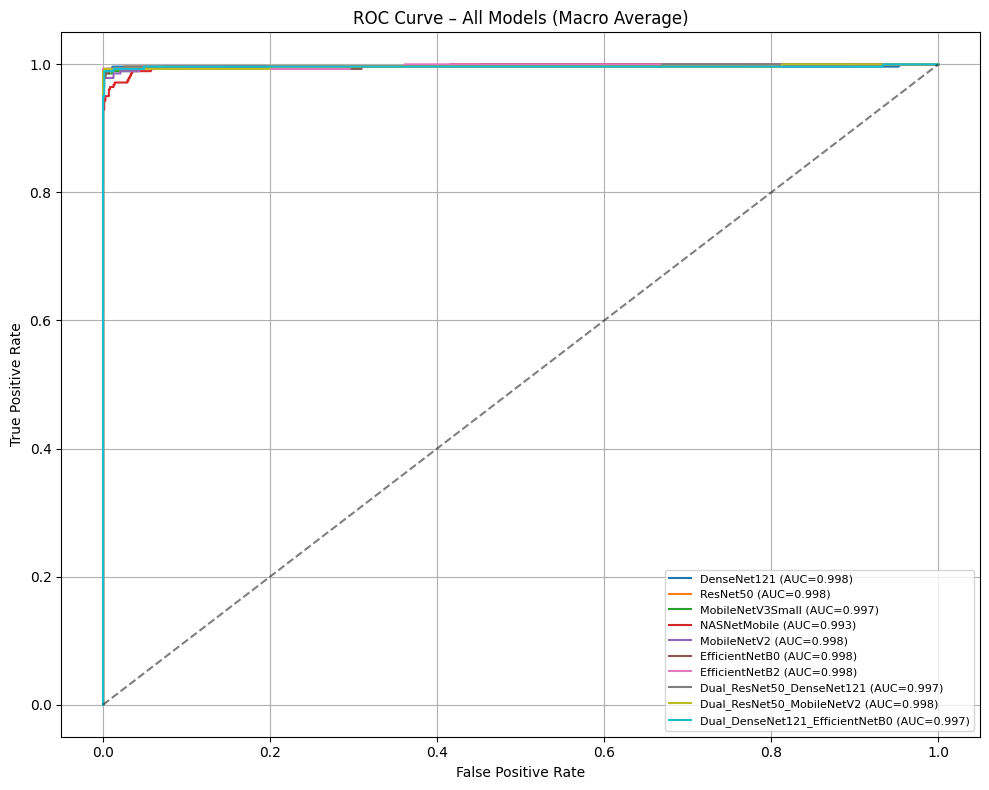

In [33]:
plt.figure(figsize=(10, 8))

for model_name, obj in RESULTS.items():
    model = obj["model"]
    test_gen = obj["test_gen"]

    # Gerçek etiketler
    y_true = test_gen.classes
    y_true_bin = label_binarize(y_true, classes=range(NUM_CLASSES))

    # Tahmin olasılıkları
    y_pred = model.predict(test_gen, verbose=0)

    # Macro-average ROC
    fpr = dict()
    tpr = dict()
    roc_auc = []

    for i in range(NUM_CLASSES):
        fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_pred[:, i])
        roc_auc.append(auc(fpr[i], tpr[i]))

    plt.plot(
        fpr[0],
        tpr[0],
        label=f"{model_name} (AUC={np.mean(roc_auc):.3f})"
    )

plt.plot([0, 1], [0, 1], "k--", alpha=0.5)
plt.title("ROC Curve – All Models (Macro Average)")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(fontsize=8)
plt.grid(True)
plt.tight_layout()
plt.show()


In [23]:
plt.figure(figsize=(10, 8))

for model_name, obj in RESULTS.items():
    model = obj["model"]
    test_gen = obj["test_gen"]

    # Gerçek etiketler
    y_true = test_gen.classes
    y_true_bin = label_binarize(y_true, classes=range(NUM_CLASSES))

    # Tahmin olasılıkları
    y_pred = model.predict(test_gen, verbose=0)

    # Macro-average ROC
    fpr = dict()
    tpr = dict()
    roc_auc = []

    for i in range(NUM_CLASSES):
        fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_pred[:, i])
        roc_auc.append(auc(fpr[i], tpr[i]))

    plt.plot(
        fpr[0],
        tpr[0],
        label=f"{model_name} (AUC={np.mean(roc_auc):.3f})"
    )

plt.plot([0, 1], [0, 1], "k--", alpha=0.5)

plt.title("ROC Curve – All Models (Macro Average)")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")

# 🔥 KRİTİK SATIRLAR
plt.ylim(0.8, 1.0)     # ← burayı 0.7 / 0.85 yapabilirsin
plt.xlim(0.0, 1.0)

plt.legend(fontsize=8)
plt.grid(True)
plt.tight_layout()
plt.show()


KeyError: 'test_gen'

In [40]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore
from tf_keras_vis.utils import normalize


In [41]:
def get_three_test_images(test_gen):
    test_gen.reset()
    images, labels = next(test_gen)
    return images[:3], labels[:3]


In [42]:
def find_last_conv_layer(model):
    for layer in reversed(model.layers):
        if isinstance(layer, tf.keras.layers.Conv2D):
            return layer.name
    raise ValueError("Conv layer bulunamadı")


In [ ]:
def run_gradcam_three_images(model, model_name, test_gen):
    print(f"\n🧠 Grad-CAM++ → {model_name}")

    images, labels = get_three_test_images(test_gen)
    last_conv = find_last_conv_layer(model)

    cam = GradcamPlusPlus(
        model,
        model_modifier=ReplaceToLinear(),
        clone=True
    )

    plt.figure(figsize=(15, 6))

    for i in range(3):
        img = images[i]
        label = labels[i]

        score = CategoricalScore(np.argmax(label))

        heatmap = cam(
            score,
            np.expand_dims(img, axis=0),
            penultimate_layer=last_conv
        )
        heatmap = normalize(heatmap[0])

        # 🔹 ÜST SATIR — HAM
        plt.subplot(2, 3, i + 1)
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"Original {i+1}")

        # 🔥 ALT SATIR — GRADCAM
        plt.subplot(2, 3, i + 4)
        plt.imshow(img)
        plt.imshow(heatmap, cmap="jet", alpha=0.45)
        plt.axis("off")
        plt.title(f"Grad-CAM {i+1}")

    plt.suptitle(f"Grad-CAM Visualization — {model_name}", fontsize=14)
    plt.tight_layout()
    plt.show()

In [30]:
def run_gradcam_three_images(model, model_name, test_gen):
    print(f"\n🧠 Grad-CAM++ → {model_name}")

    images, labels = get_three_test_images(test_gen)
    last_conv = find_last_conv_layer(model)

    cam = GradcamPlusPlus(
        model,
        model_modifier=ReplaceToLinear(),
        clone=True
    )

    # 🔥 Figure daha büyük + DPI arttı
    plt.figure(figsize=(20, 9), dpi=120)

    for i in range(3):
        img = images[i]
        label = labels[i]

        score = CategoricalScore(np.argmax(label))

        heatmap = cam(
            score,
            np.expand_dims(img, axis=0),
            penultimate_layer=last_conv
        )
        heatmap = normalize(heatmap[0])

        # 🔹 ÜST SATIR — ORİJİNAL
        plt.subplot(2, 3, i + 1)
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"Original Image {i+1}", fontsize=12)

        # 🔥 ALT SATIR — GRAD-CAM
        plt.subplot(2, 3, i + 4)
        plt.imshow(img)
        plt.imshow(heatmap, cmap="jet", alpha=0.45)
        plt.axis("off")
        plt.title(f"Grad-CAM++ {i+1}", fontsize=12)

    plt.suptitle(
        f"Grad-CAM++ Visualization — {model_name}",
        fontsize=16,
        fontweight="bold"
    )

    # 🔹 Boşluklar daha dengeli
    plt.tight_layout(rect=[0, 0, 1, 0.93])
    plt.show()


In [32]:
for model_name, obj in RESULTS.items():
    if "Dual" not in model_name:
        run_gradcam_three_images(
            obj["model"],
            model_name,
            test_gen   # 🔥 tek ve doğru kaynak
        )



🧠 Grad-CAM++ → DenseNet121


NameError: name 'get_three_test_images' is not defined